In [1]:
# 除肋间肌以外的MuSC合并在一起，看一下结果

# Diaphragm      膈肌
# Pectoralis     胸大肌
# Rectus abdominis 腹直肌
# Right external oblique 腹外斜肌
# Vastus  股外肌
# Rectus  股直肌

import numpy as np
import pandas as pd
import scanpy as sc
import anndata
import os
from scipy import sparse
import collections
import matplotlib.pyplot as plt
import time
import random
import scipy
from collections import Counter
import scipy.io
import bbknn

sc.settings.verbosity = 3
sc.settings.set_figure_params(dpi=100, color_map='YlOrRd')
sc.logging.print_version_and_date()



Running Scanpy 1.9.1, on 2023-06-18 22:22.


***
Import data

In [2]:
# intercostal muscle
Sanger_rawadata = sc.read('./write/skm_cells_human_cellbender.raw_2021-03-24.h5ad')
Sanger_adata_annotation = sc.read('/public/LiuTL/jupyter_notebook/skeletal_muscle/human_sanger_v2/write/human_SKM_sc_cellbender_v2.0_adata_bbknn_clean.h5ad')

In [3]:
cell_list = Sanger_adata_annotation[Sanger_adata_annotation.obs['annotation']=='1-MuSCs'].obs.index

Sanger_adata = Sanger_rawadata[cell_list]

In [4]:
Sanger_adata

View of AnnData object with n_obs × n_vars = 15788 × 33694
    obs: 'sample', 'barcode', 'DonorID', 'Sex', 'Age', 'Species', 'Operator', 'Sample', 'SampleID', 'NoCells', 'NoGenes', 'QC', 'Sequencing saturation', '10X version ', 'Age_bin', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo'
    var: 'GeneID', 'feature_types', 'genome', 'GeneName', 'n_counts', 'n_cells'

In [5]:
sex_list = []
for i in list(Sanger_adata.obs['Sex']):
    if i == 'F':
        sex_list.append('female')
    elif i == 'M':
        sex_list.append('male')

In [6]:
Sanger_adata.obs=Sanger_adata.obs.rename(columns={'Age':'Age_yo','percent_mito':'Mito_per','DonorID':'Sample_ID',})

In [7]:
Sanger_adata.obs['10X_chemistry'] = 'v2'
Sanger_adata.obs['Muscle'] = 'Intercostal_Muscles'
Sanger_adata.obs['Source'] = 'Sanger_Zhang_human'
Sanger_adata.obs['Sex'] = sex_list

Sanger_adata.var['human_gene'] = Sanger_adata.var.index
Sanger_adata.obs['Species'] = 'human'

In [8]:
Sanger_adata.obs.drop(['sample', 'barcode','Operator', 'Sample', 'SampleID', 'NoCells', 'NoGenes', 'QC', 'Sequencing saturation', '10X version ','n_counts', 'n_genes','percent_ribo', ],axis=1,inplace=True)

In [9]:
Sanger_adata

AnnData object with n_obs × n_vars = 15788 × 33694
    obs: 'Sample_ID', 'Sex', 'Age_yo', 'Species', 'Age_bin', 'Mito_per', '10X_chemistry', 'Muscle', 'Source'
    var: 'GeneID', 'feature_types', 'genome', 'GeneName', 'n_counts', 'n_cells', 'human_gene'

In [10]:
# elife data
elife_rawadata = sc.read('./write/human_MuSC_elife_v1.0_clean.h5ad')
elife_adata_annotation = sc.read('./write/human_MuSC_elife_all_muscle_scvi_v1.0_adata.h5ad')

In [11]:
collections.Counter(elife_adata_annotation.obs['Muscle'])

Counter({'Pectoralis': 9146,
         'Rectus_abdominis': 21736,
         'Vastus': 70627,
         'Rectus_femoris': 5049})

In [12]:
elife_adata_annotation

AnnData object with n_obs × n_vars = 106558 × 10000
    obs: 'Sample_ID', 'doublet_scores', 'predicted_doublets', 'Sex', 'Age_yo', 'Muscle', 'Age_bin', 'batch', 'Source', 'Species', '10X_chemistry', 'Mito_per', '_scvi_batch', '_scvi_labels', '_scvi_local_l_mean', '_scvi_local_l_var', 'leiden'
    var: 'GeneName', 'mito', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: '_scvi', 'hvg', 'leiden', 'neighbors', 'umap'
    obsm: 'X_scVI', 'X_umap', '_scvi_extra_categoricals', '_scvi_extra_continuous'
    layers: 'counts'
    obsp: 'connectivities', 'distances'

In [13]:
collections.Counter(elife_adata_annotation.obs['Sample_ID'])

Counter({'Pectoralis21F': 6826,
         'Pectoralis40F': 2320,
         'Rectus56F': 19409,
         'Rectus59F': 2327,
         'Vastus20M': 4612,
         'Vastus52M': 19689,
         'Vastus55M': 9685,
         'Vastus57F': 16672,
         'Vastus73M': 4289,
         'Vastus83M': 4611,
         'Vastus66M': 3556,
         'Vastus56M': 7513,
         'Rectus84M': 5049})

In [141]:
19689+9685+16672+4289+4611+3556+7513

66015

In [ ]:
14

In [14]:
list_0 = random.sample(list(elife_adata_annotation[elife_adata_annotation.obs['Sample_ID']=='Rectus56F'].obs.index),5000)
list_1 = random.sample(list(elife_adata_annotation[elife_adata_annotation.obs['Sample_ID']=='Vastus52M'].obs.index),2000)
list_2 = random.sample(list(elife_adata_annotation[elife_adata_annotation.obs['Sample_ID']=='Vastus55M'].obs.index),2000)
list_3 = random.sample(list(elife_adata_annotation[elife_adata_annotation.obs['Sample_ID']=='Vastus57F'].obs.index),2000)
list_4 = random.sample(list(elife_adata_annotation[elife_adata_annotation.obs['Sample_ID']=='Vastus73M'].obs.index),2000)
list_5 = random.sample(list(elife_adata_annotation[elife_adata_annotation.obs['Sample_ID']=='Vastus83M'].obs.index),2000)
list_6 = random.sample(list(elife_adata_annotation[elife_adata_annotation.obs['Sample_ID']=='Vastus66M'].obs.index),2000)
list_7 = random.sample(list(elife_adata_annotation[elife_adata_annotation.obs['Sample_ID']=='Vastus56M'].obs.index),2000)

list_8 = list(elife_adata_annotation[elife_adata_annotation.obs['Sample_ID']=='Pectoralis21F'].obs.index)
list_9 = list(elife_adata_annotation[elife_adata_annotation.obs['Sample_ID']=='Pectoralis40F'].obs.index)
list_10 = list(elife_adata_annotation[elife_adata_annotation.obs['Sample_ID']=='Rectus59F'].obs.index)
list_11 = list(elife_adata_annotation[elife_adata_annotation.obs['Sample_ID']=='Rectus84M'].obs.index)

list_12 = list(elife_adata_annotation[elife_adata_annotation.obs['Sample_ID']=='Vastus20M'].obs.index)

In [15]:
cell_list = list_0+list_1+list_2+list_3+list_4+list_5+list_6+list_7+list_8+list_9+list_10+list_11+list_12

In [16]:
elife_adata = elife_adata_annotation[cell_list]

In [17]:
elife_adata

View of AnnData object with n_obs × n_vars = 40134 × 10000
    obs: 'Sample_ID', 'doublet_scores', 'predicted_doublets', 'Sex', 'Age_yo', 'Muscle', 'Age_bin', 'batch', 'Source', 'Species', '10X_chemistry', 'Mito_per', '_scvi_batch', '_scvi_labels', '_scvi_local_l_mean', '_scvi_local_l_var', 'leiden'
    var: 'GeneName', 'mito', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: '_scvi', 'hvg', 'leiden', 'neighbors', 'umap'
    obsm: 'X_scVI', 'X_umap', '_scvi_extra_categoricals', '_scvi_extra_continuous'
    layers: 'counts'
    obsp: 'connectivities', 'distances'

In [18]:
collections.Counter(elife_adata.obs['Sample_ID'])

Counter({'Rectus56F': 5000,
         'Vastus52M': 2000,
         'Vastus55M': 2000,
         'Vastus57F': 2000,
         'Vastus73M': 2000,
         'Vastus83M': 2000,
         'Vastus66M': 2000,
         'Vastus56M': 2000,
         'Pectoralis21F': 6826,
         'Pectoralis40F': 2320,
         'Rectus59F': 2327,
         'Rectus84M': 5049,
         'Vastus20M': 4612})

In [19]:
cell_list1 = elife_adata[elife_adata.obs['leiden']=='0'].obs.index
cell_list2 = elife_adata[elife_adata.obs['leiden']=='1'].obs.index
cell_list3 = elife_adata[elife_adata.obs['leiden']=='2'].obs.index
cell_list4 = elife_adata[elife_adata.obs['leiden']=='3'].obs.index
cell_list5 = elife_adata[elife_adata.obs['leiden']=='4'].obs.index
cell_list6 = elife_adata[elife_adata.obs['leiden']=='5'].obs.index
cell_list7 = elife_adata[elife_adata.obs['leiden']=='6'].obs.index
cell_list8 = elife_adata[elife_adata.obs['leiden']=='7'].obs.index
cell_list9 = elife_adata[elife_adata.obs['leiden']=='8'].obs.index
cell_list10 = elife_adata[elife_adata.obs['leiden']=='9'].obs.index
cell_list11 = elife_adata[elife_adata.obs['leiden']=='10'].obs.index
cell_list12 = elife_adata[elife_adata.obs['leiden']=='11'].obs.index
cell_list13 = elife_adata[elife_adata.obs['leiden']=='12'].obs.index
cell_list14 = elife_adata[elife_adata.obs['leiden']=='13'].obs.index
cell_list15 = elife_adata[elife_adata.obs['leiden']=='14'].obs.index
cell_list16 = elife_adata[elife_adata.obs['leiden']=='16'].obs.index

cell_list = cell_list1.append(cell_list2).append(cell_list3).append(cell_list4).append(cell_list5).append(cell_list6).append(cell_list7).append(cell_list8).append(cell_list9).append(cell_list10).append(cell_list11).append(cell_list12).append(cell_list13).append(cell_list14).append(cell_list15).append(cell_list16)

In [20]:
elife_adata = elife_rawadata[cell_list]

In [21]:
collections.Counter(elife_adata.obs['Sample_ID'])

Counter({'Rectus56F': 4968,
         'Vastus52M': 1978,
         'Vastus55M': 1995,
         'Vastus57F': 1994,
         'Vastus73M': 1993,
         'Vastus83M': 1850,
         'Vastus66M': 1943,
         'Vastus56M': 1847,
         'Pectoralis21F': 6807,
         'Pectoralis40F': 2299,
         'Rectus59F': 2286,
         'Rectus84M': 4927,
         'Vastus20M': 4583})

In [22]:
collections.Counter(elife_adata.obs['Muscle'])

Counter({'Rectus_abdominis': 7254,
         'Vastus': 18183,
         'Pectoralis': 9106,
         'Rectus_femoris': 4927})

In [23]:
elife_adata

View of AnnData object with n_obs × n_vars = 39470 × 30316
    obs: 'Sample_ID', 'doublet_scores', 'predicted_doublets', 'Sex', 'Age_yo', 'Muscle', 'Age_bin', 'batch', 'Source', 'Species', '10X_chemistry', 'Mito_per'
    var: 'GeneName', 'mito'

In [24]:
# GSE data
GSE_rawadata = sc.read('./write/human_SKM_sc_GSE143704_v1.0_raw.h5ad')
GSE_adata_annotation = sc.read('./write/human_MuSC_GSE143704_all_muscle_scvi_v1.0_adata.h5ad')

In [25]:
GSE_adata_annotation

AnnData object with n_obs × n_vars = 3124 × 10000
    obs: 'Sample_ID', 'annotation', '10X_chemistry', 'Muscle', 'Sex', 'Age_yo', 'Species', 'Age_bin', 'Source', 'Mito_per', '_scvi_batch', '_scvi_labels', '_scvi_local_l_mean', '_scvi_local_l_var', 'leiden'
    var: 'GeneName', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: '_scvi', 'hvg', 'leiden', 'neighbors', 'umap'
    obsm: 'X_scVI', 'X_umap', '_scvi_extra_categoricals', '_scvi_extra_continuous'
    layers: 'counts'
    obsp: 'connectivities', 'distances'

In [26]:
cell_list = GSE_adata_annotation.obs.index

In [27]:
GSE_adata = GSE_rawadata[cell_list]

In [28]:
collections.Counter(GSE_adata.obs['Muscle'])

Counter({'Vastus': 544,
         'Rectus_abdominis': 819,
         'Trapezius': 320,
         'External oblique': 1310,
         'Flexor hallucis longus': 91,
         'Right serratus': 15,
         'Orbicularis oris': 6,
         'Eye lid': 19})

In [29]:
GSE_adata

View of AnnData object with n_obs × n_vars = 3124 × 21703
    obs: 'Sample_ID', 'annotation', '10X_chemistry', 'Muscle', 'Sex', 'Age_yo', 'Species', 'Age_bin', 'Source', 'Mito_per'
    var: 'GeneName'

In [30]:
# Tabula data
Tabula_rawadata = sc.read('./write/human_SKM_sc_Tabula_v1.0_adata.h5ad')
Tabula_adata_annotation = sc.read('./write/human_MuSC_Tabula_all_muscle_scvi_v1.0_adata.h5ad')

In [31]:
Tabula_rawadata

AnnData object with n_obs × n_vars = 25666 × 31437
    obs: 'Sample_ID', 'Sex', 'Age_yo', 'Species', 'Age_bin', 'Mito_per', 'annotation_old', '10X_chemistry', 'anatomical_information', 'Muscle', 'Source', 'n_genes', 'n_counts'
    var: 'mito', 'gene_ids', 'n_cells'
    layers: 'count'

In [32]:
del Tabula_rawadata.layers['count']

In [33]:
cell_list1 = Tabula_adata_annotation[Tabula_adata_annotation.obs['annotation']=='0'].obs.index
cell_list2 = Tabula_adata_annotation[Tabula_adata_annotation.obs['annotation']=='1'].obs.index
cell_list3 = Tabula_adata_annotation[Tabula_adata_annotation.obs['annotation']=='2'].obs.index
cell_list4 = Tabula_adata_annotation[Tabula_adata_annotation.obs['annotation']=='3'].obs.index
cell_list5 = Tabula_adata_annotation[Tabula_adata_annotation.obs['annotation']=='4'].obs.index
cell_list6 = Tabula_adata_annotation[Tabula_adata_annotation.obs['annotation']=='5'].obs.index
cell_list7 = Tabula_adata_annotation[Tabula_adata_annotation.obs['annotation']=='6'].obs.index
cell_list8 = Tabula_adata_annotation[Tabula_adata_annotation.obs['annotation']=='7'].obs.index
cell_list9 = Tabula_adata_annotation[Tabula_adata_annotation.obs['annotation']=='8'].obs.index
cell_list10 = Tabula_adata_annotation[Tabula_adata_annotation.obs['annotation']=='9'].obs.index
cell_list11 = Tabula_adata_annotation[Tabula_adata_annotation.obs['annotation']=='10'].obs.index
cell_list12 = Tabula_adata_annotation[Tabula_adata_annotation.obs['annotation']=='11'].obs.index
cell_list13 = Tabula_adata_annotation[Tabula_adata_annotation.obs['annotation']=='12'].obs.index

cell_list = cell_list1.append(cell_list2).append(cell_list3).append(cell_list4).append(cell_list5).append(cell_list6).append(cell_list7).append(cell_list8).append(cell_list9).append(cell_list10).append(cell_list11).append(cell_list12).append(cell_list13)

In [34]:
Tabula_adata = Tabula_rawadata[cell_list]

In [35]:
collections.Counter(Tabula_adata.obs['Muscle'])

Counter({'Rectus_abdominis': 3019, 'Diaphragm': 942, 'nan': 232})

In [36]:
Tabula_adata

View of AnnData object with n_obs × n_vars = 4193 × 31437
    obs: 'Sample_ID', 'Sex', 'Age_yo', 'Species', 'Age_bin', 'Mito_per', 'annotation_old', '10X_chemistry', 'anatomical_information', 'Muscle', 'Source', 'n_genes', 'n_counts'
    var: 'mito', 'gene_ids', 'n_cells'

In [37]:
adata = elife_adata.concatenate(GSE_adata,Tabula_adata,Sanger_adata)

/home/LiuTL/anaconda3/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],


In [38]:
adata

AnnData object with n_obs × n_vars = 62575 × 15967
    obs: 'Sample_ID', 'doublet_scores', 'predicted_doublets', 'Sex', 'Age_yo', 'Muscle', 'Age_bin', 'batch', 'Source', 'Species', '10X_chemistry', 'Mito_per', 'annotation', 'annotation_old', 'anatomical_information', 'n_genes', 'n_counts'
    var: 'GeneName-0', 'mito-0', 'GeneName-1', 'mito-2', 'gene_ids-2', 'n_cells-2', 'GeneName-3', 'n_cells-3', 'GeneID-3', 'feature_types-3', 'genome-3', 'n_counts-3', 'human_gene-3'

In [39]:
adata.layers['counts'] = adata.X.copy()

In [40]:
collections.Counter(adata.obs['Sample_ID'])

Counter({'Rectus56F': 4968,
         'Vastus52M': 1978,
         'Vastus55M': 1995,
         'Vastus57F': 1994,
         'Vastus73M': 1993,
         'Vastus83M': 1850,
         'Vastus66M': 1943,
         'Vastus56M': 1847,
         'Pectoralis21F': 6807,
         'Pectoralis40F': 2299,
         'Rectus59F': 2286,
         'Rectus84M': 4927,
         'Vastus20M': 4583,
         'hu08_092618': 544,
         'hu10_101018': 819,
         'hu05_111418': 320,
         'hu06_120518': 1310,
         'hu07_021219': 29,
         'hu01_061419': 15,
         'hu02_062419': 62,
         'hu03_062719': 6,
         'hu04_080619': 19,
         'TSP14': 1641,
         'TSP1': 232,
         'TSP2': 2320,
         '339C': 1347,
         '343B': 755,
         '362C': 826,
         '367C': 1280,
         '411C': 3897,
         '464C': 521,
         '470BR': 2767,
         '582C': 266,
         '583B': 2434,
         '591C': 1695})

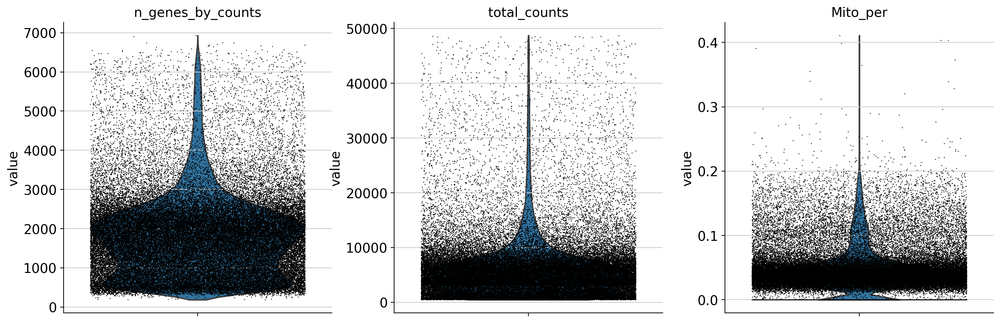

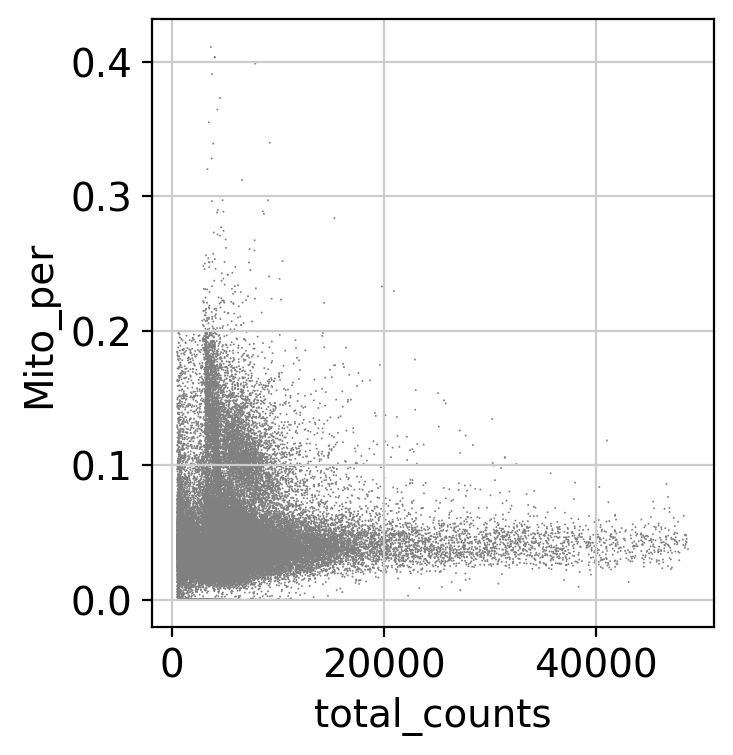

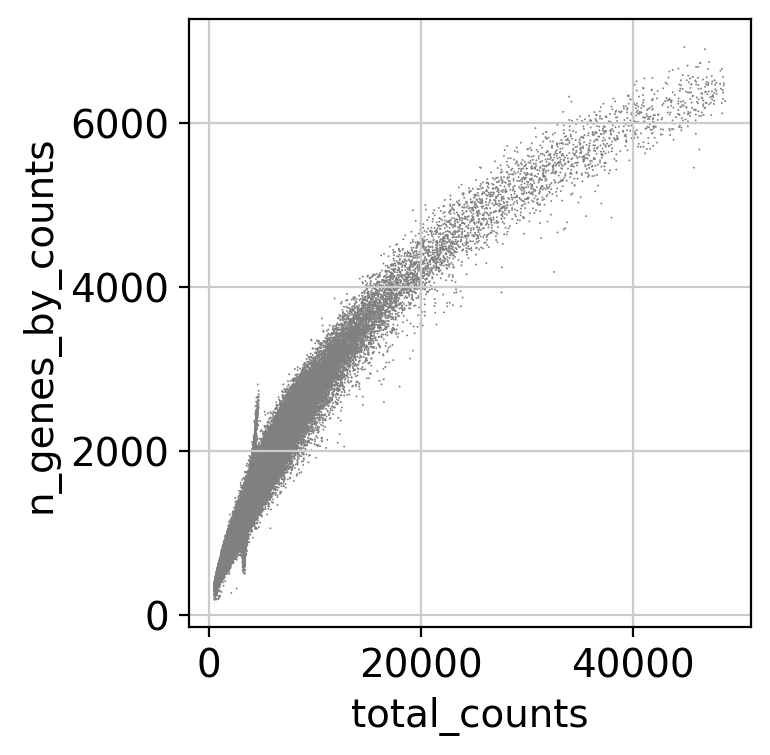

normalizing by total count per cell
    finished (0:00:03): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)
extracting highly variable genes
    finished (0:00:03)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


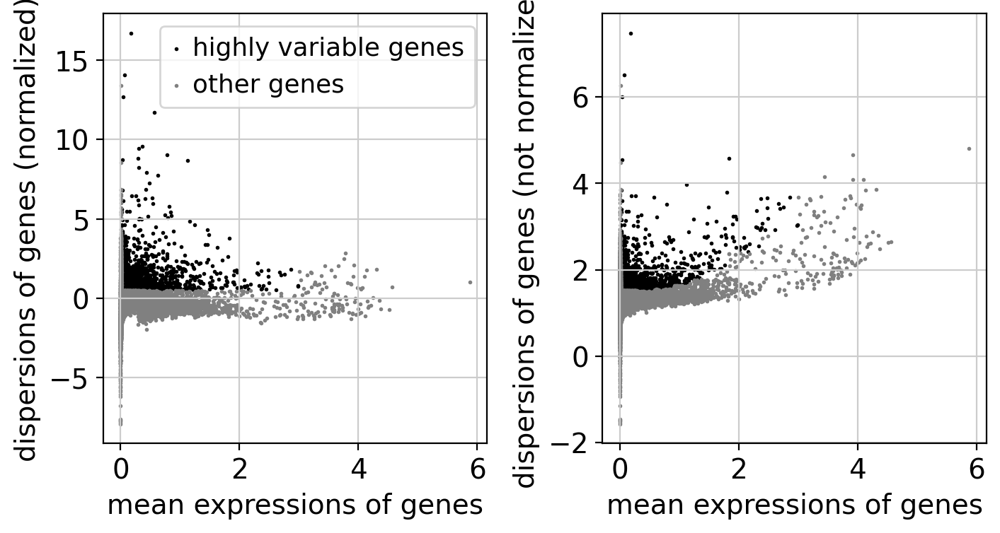

/home/LiuTL/anaconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
computing PCA
Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.`
    on highly variable genes
    with n_comps=50
    finished (0:00:07)


/home/LiuTL/anaconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


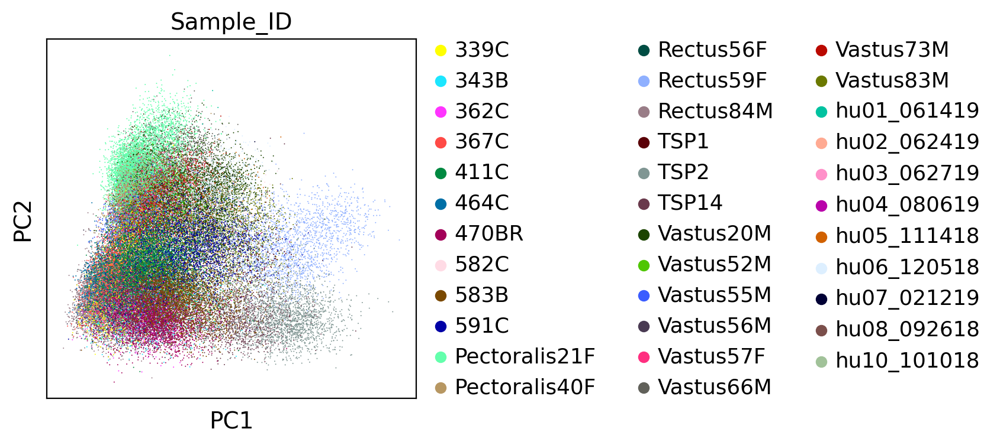

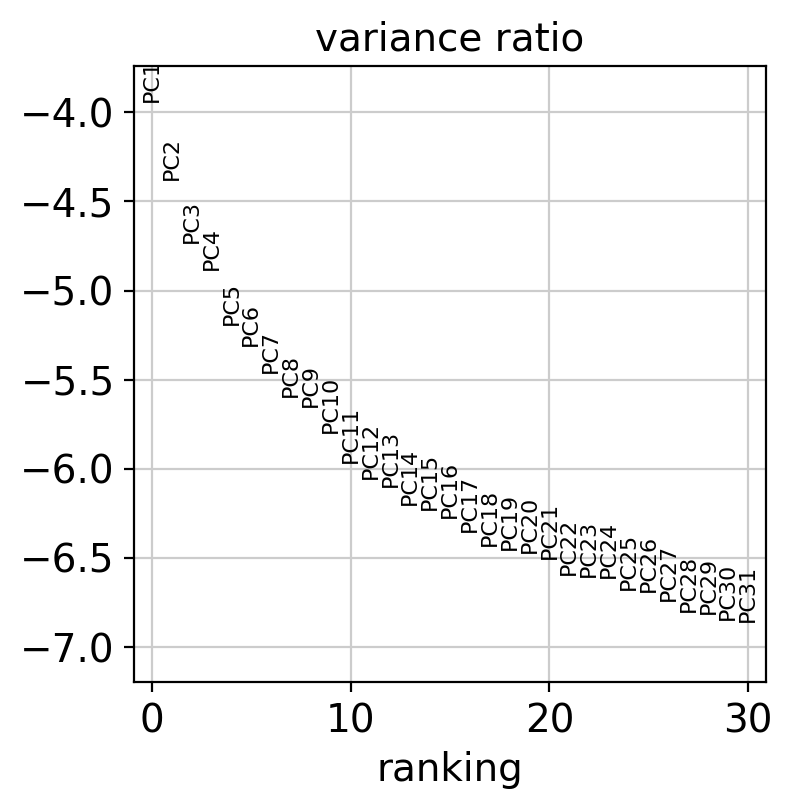

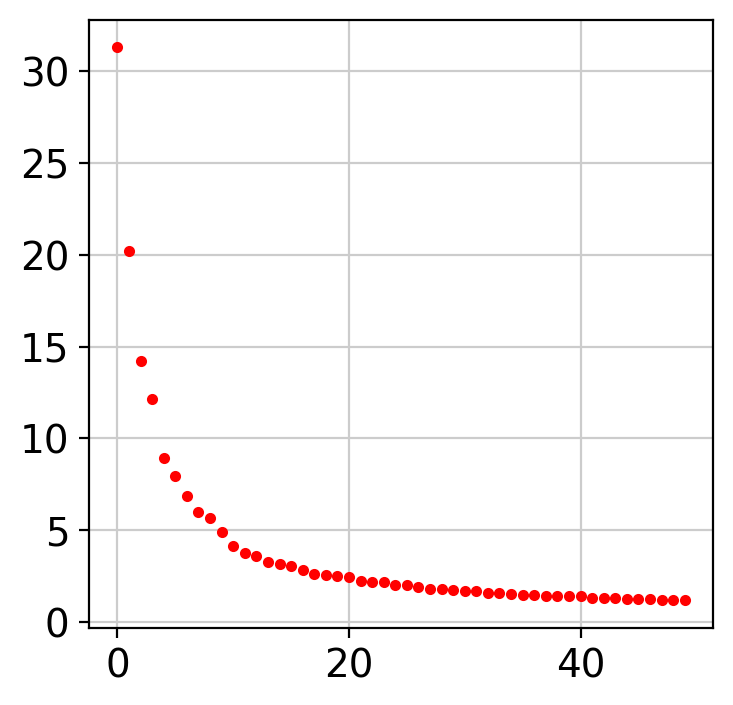

In [41]:
sc.pp.calculate_qc_metrics(adata, inplace=True)
sc.pl.violin(adata,['n_genes_by_counts','total_counts','Mito_per'],jitter=0.4, multi_panel=True)
sc.pl.scatter(adata, x='total_counts', y='Mito_per')
sc.pl.scatter(adata, x='total_counts', y='n_genes_by_counts')
sc.pp.normalize_per_cell(adata, counts_per_cell_after = 1e4)
sc.pp.log1p(adata)

sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=3, min_disp=0.5)
sc.pl.highly_variable_genes(adata)
adata.raw = adata
adata = adata[:, adata.var['highly_variable']]
sc.pp.scale(adata, max_value=10)

sc.tl.pca(adata, svd_solver='auto')
sc.pl.pca(adata,color='Sample_ID')
sc.pl.pca_variance_ratio(adata, log=True)
plt.plot(adata.uns['pca']['variance'],'r.')

In [42]:
number_pcs = 30

In [117]:
adata_bbknn_scale_v1.write('./write/human_MuSC_all_muscle_bbknn_v1.1_adata_bbknn.h5ad')

In [2]:
adata_bbknn_scale_v1 = sc.read('./write/human_MuSC_all_muscle_bbknn_v1.1_adata_bbknn.h5ad')

In [3]:
adata_bbknn_scale_v1

AnnData object with n_obs × n_vars = 62575 × 1788
    obs: 'Sample_ID', 'doublet_scores', 'Sex', 'Age_yo', 'Muscle', 'Age_bin', 'batch', 'Source', 'Species', '10X_chemistry', 'Mito_per', 'annotation', 'annotation_old', 'anatomical_information', 'n_genes', 'n_counts', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'leiden', 'score', 'Age_bin1', 'annotation_name'
    var: 'GeneName-0', 'mito-0', 'GeneName-1', 'mito-2', 'gene_ids-2', 'n_cells-2', 'GeneName-3', 'n_cells-3', 'GeneID-3', 'feature_types-3', 'genome-3', 'n_counts-3', 'human_gene-3', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'Muscle_colors', 'Sample_ID_colors', 'Source_colors', 'annotation_colors', 'annotati

/home/LiuTL/anaconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


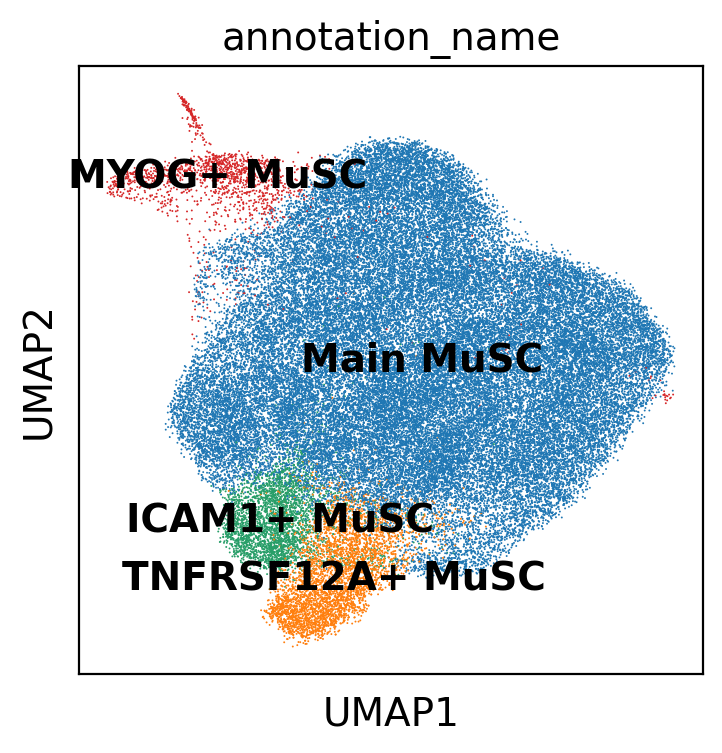

In [4]:
sc.pl.umap(adata_bbknn_scale_v1, color=['annotation_name'],legend_loc='on data')

computing batch balanced neighbors
	finished: added to `.uns['neighbors']`
	`.obsp['distances']`, distances for each pair of neighbors
	`.obsp['connectivities']`, weighted adjacency matrix (0:00:56)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:02:27)
running Leiden clustering
    finished: found 11 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:02:40)


/home/LiuTL/anaconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


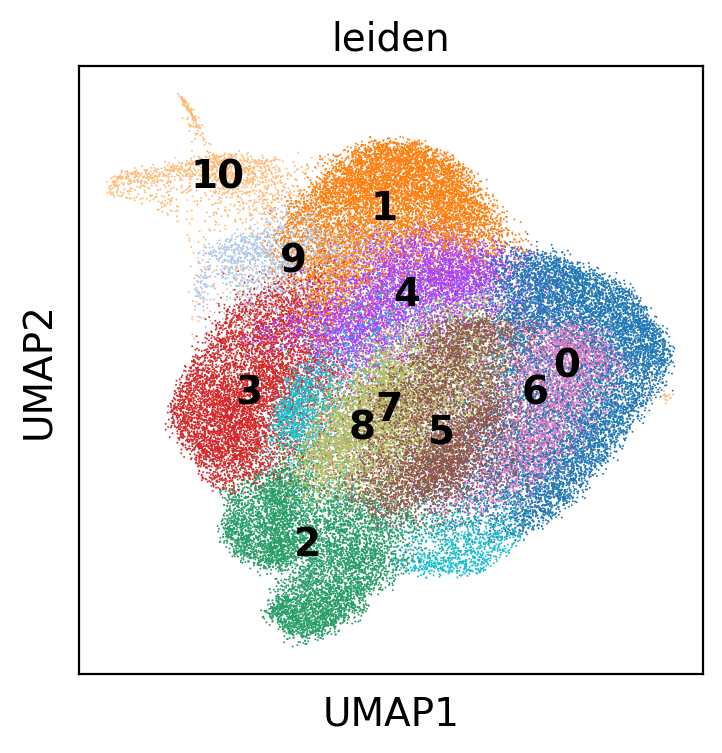

/home/LiuTL/anaconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


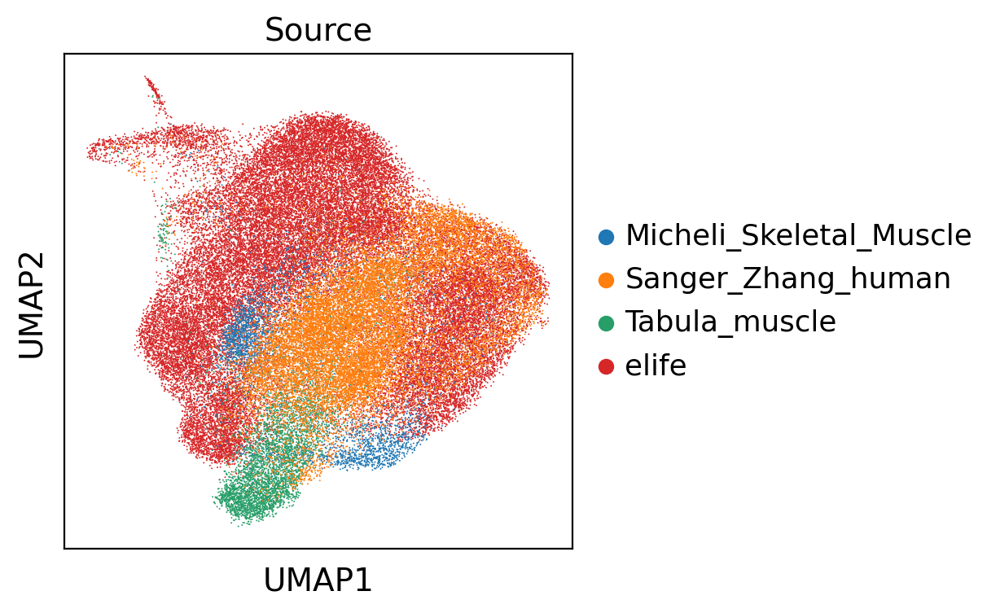

/home/LiuTL/anaconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


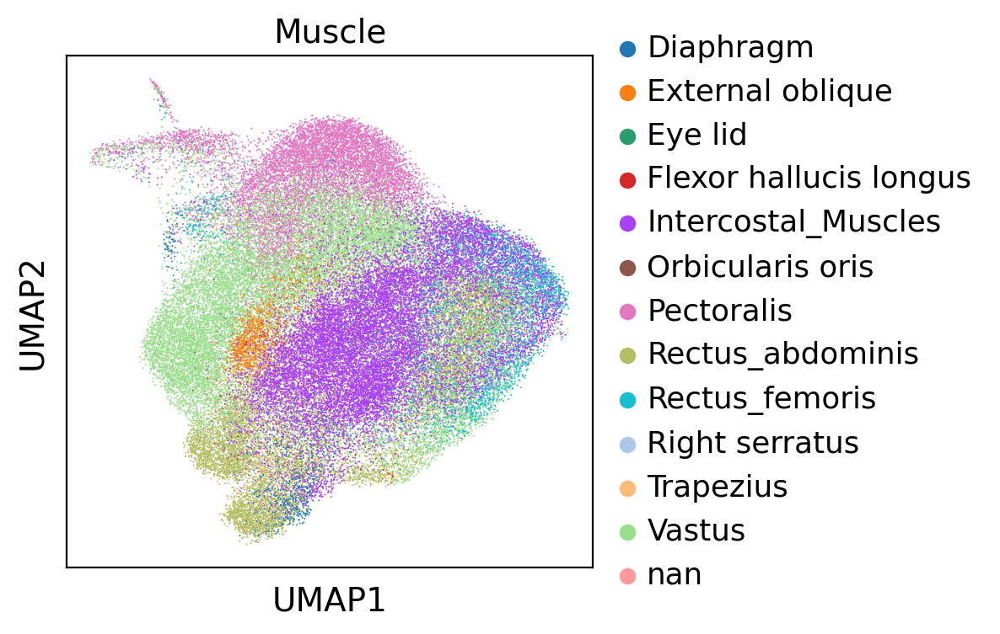

/home/LiuTL/anaconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


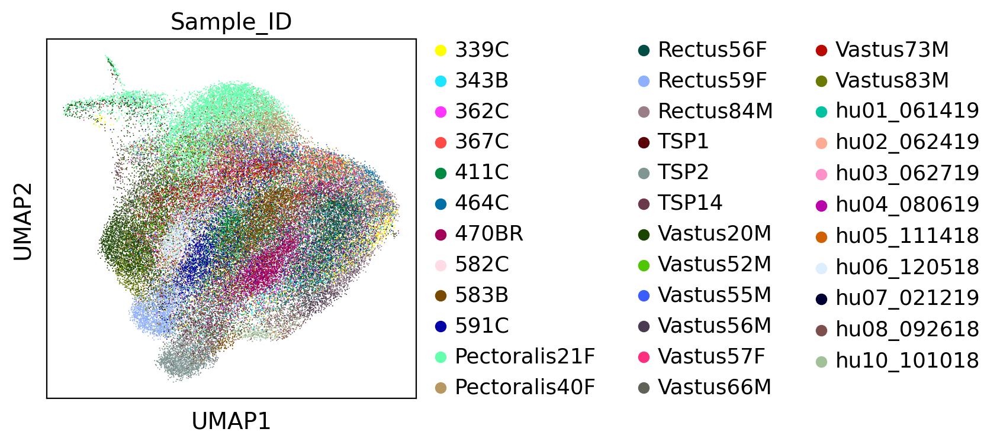

/home/LiuTL/anaconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


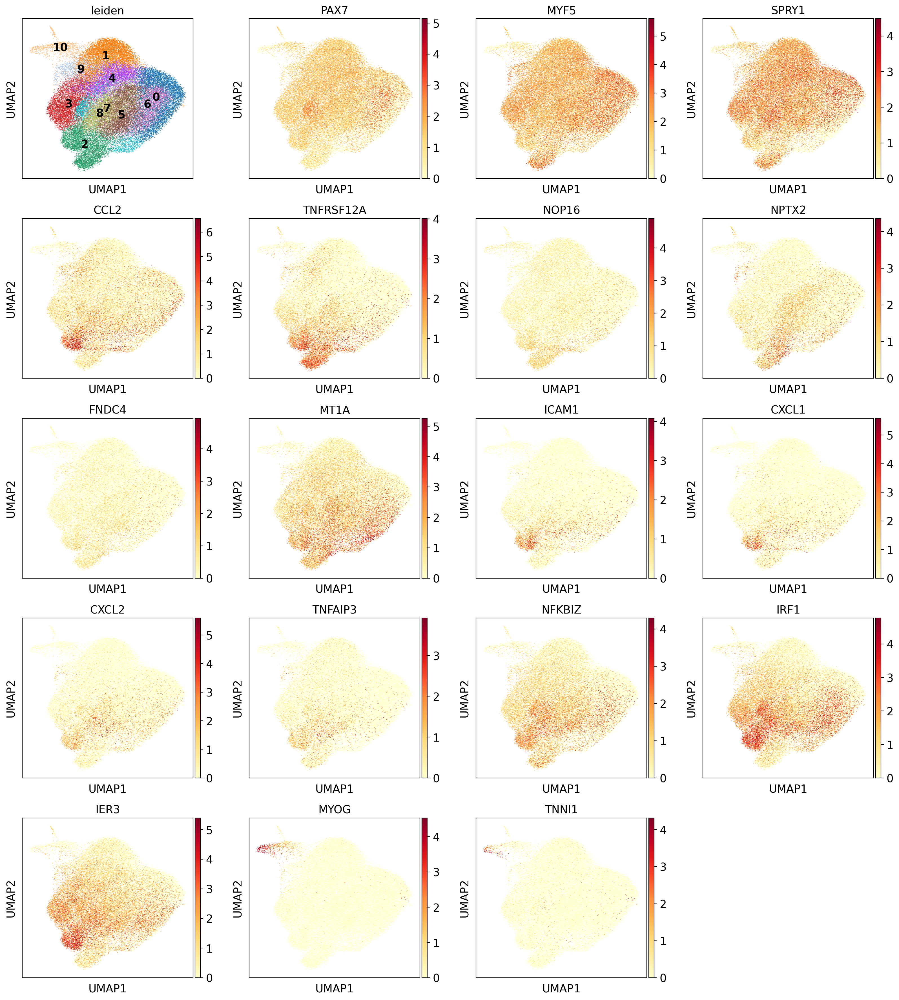

In [46]:
adata_bbknn_scale_v1 = bbknn.bbknn(adata,batch_key='Sample_ID',n_pcs=number_pcs,neighbors_within_batch=6,copy=True)
sc.tl.umap(adata_bbknn_scale_v1)
sc.tl.leiden(adata_bbknn_scale_v1,resolution=1)
sc.pl.umap(adata_bbknn_scale_v1, color=['leiden'],legend_loc='on data')
sc.pl.umap(adata_bbknn_scale_v1, color=['Source'])
sc.pl.umap(adata_bbknn_scale_v1, color=['Muscle'])
sc.pl.umap(adata_bbknn_scale_v1, color=['Sample_ID'])
sc.pl.umap(adata_bbknn_scale_v1, color=['leiden','PAX7','MYF5','SPRY1','CCL2','TNFRSF12A','NOP16','NPTX2','FNDC4','MT1A','ICAM1','CXCL1','CXCL2','TNFAIP3','NFKBIZ','IRF1','IER3','MYOG','TNNI1'],legend_loc='on data')

/home/LiuTL/anaconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


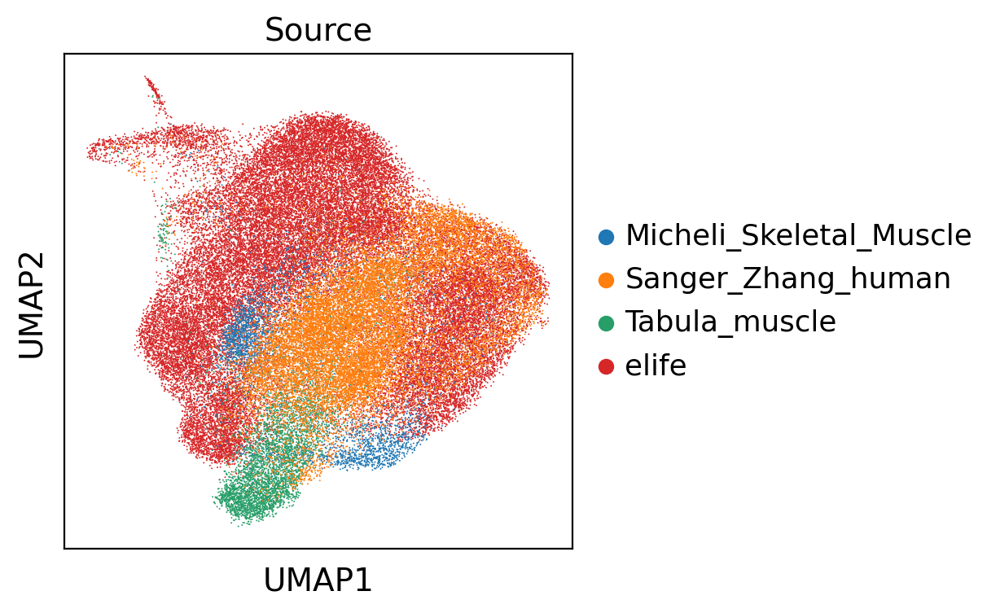

In [118]:
sc.pl.umap(adata_bbknn_scale_v1, color=['Source'],)

/home/LiuTL/anaconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: In a future version of pandas all arguments of Categorical.replace except for the argument 'value' will be keyword-only.
  values = values.replace(values.categories.difference(groups), np.nan)
/home/LiuTL/anaconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)
/home/LiuTL/anaconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


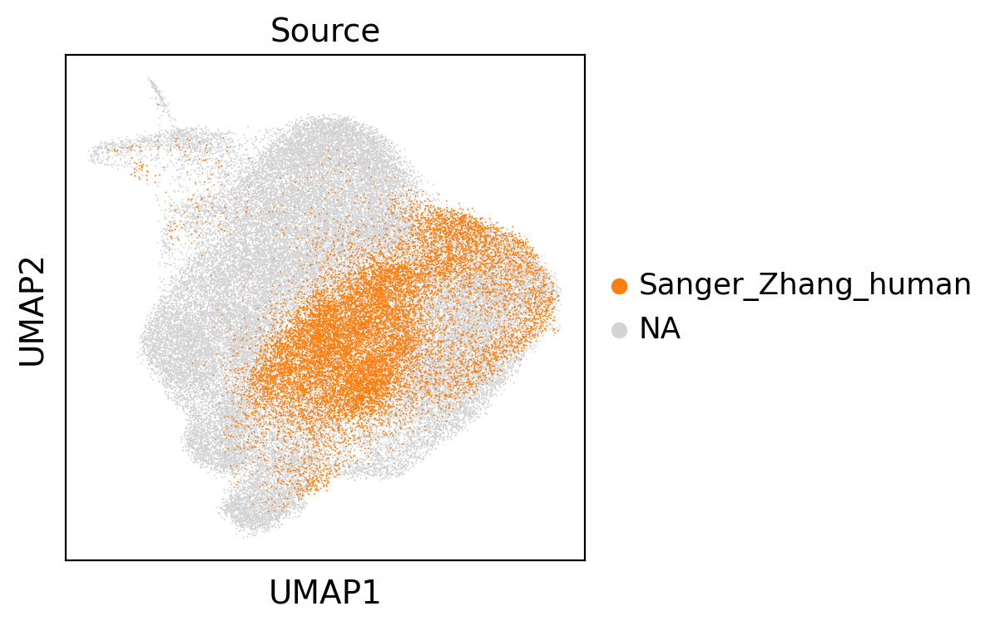

In [64]:
sc.pl.umap(adata_bbknn_scale_v1, color=['Source'],groups='Sanger_Zhang_human')

In [47]:
collections.Counter(adata.obs['Sample_ID'])

Counter({'Rectus56F': 4968,
         'Vastus52M': 1978,
         'Vastus55M': 1995,
         'Vastus57F': 1994,
         'Vastus73M': 1993,
         'Vastus83M': 1850,
         'Vastus66M': 1943,
         'Vastus56M': 1847,
         'Pectoralis21F': 6807,
         'Pectoralis40F': 2299,
         'Rectus59F': 2286,
         'Rectus84M': 4927,
         'Vastus20M': 4583,
         'hu08_092618': 544,
         'hu10_101018': 819,
         'hu05_111418': 320,
         'hu06_120518': 1310,
         'hu07_021219': 29,
         'hu01_061419': 15,
         'hu02_062419': 62,
         'hu03_062719': 6,
         'hu04_080619': 19,
         'TSP14': 1641,
         'TSP1': 232,
         'TSP2': 2320,
         '339C': 1347,
         '343B': 755,
         '362C': 826,
         '367C': 1280,
         '411C': 3897,
         '464C': 521,
         '470BR': 2767,
         '582C': 266,
         '583B': 2434,
         '591C': 1695})

In [48]:
collections.Counter(adata.obs['Source'])

Counter({'elife': 39470,
         'Micheli_Skeletal_Muscle': 3124,
         'Tabula_muscle': 4193,
         'Sanger_Zhang_human': 15788})

/home/LiuTL/anaconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


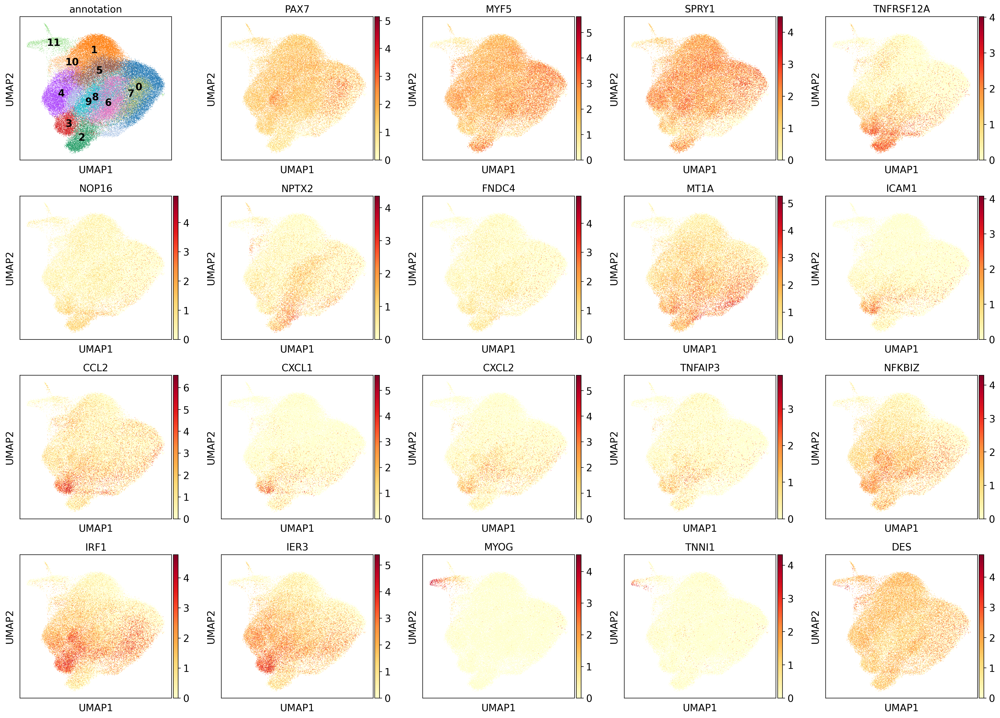

In [67]:
sc.pl.umap(adata_bbknn_scale_v1, color=['annotation','PAX7','MYF5','SPRY1','TNFRSF12A','NOP16','NPTX2','FNDC4','MT1A','ICAM1','CCL2','CXCL1','CXCL2','TNFAIP3','NFKBIZ','IRF1','IER3','MYOG','TNNI1','DES'],ncols=5,legend_loc='on data')

In [5]:
adata_bbknn_scale_v1

AnnData object with n_obs × n_vars = 62575 × 1788
    obs: 'Sample_ID', 'doublet_scores', 'Sex', 'Age_yo', 'Muscle', 'Age_bin', 'batch', 'Source', 'Species', '10X_chemistry', 'Mito_per', 'annotation', 'annotation_old', 'anatomical_information', 'n_genes', 'n_counts', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'leiden', 'score', 'Age_bin1', 'annotation_name'
    var: 'GeneName-0', 'mito-0', 'GeneName-1', 'mito-2', 'gene_ids-2', 'n_cells-2', 'GeneName-3', 'n_cells-3', 'GeneID-3', 'feature_types-3', 'genome-3', 'n_counts-3', 'human_gene-3', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'Muscle_colors', 'Sample_ID_colors', 'Source_colors', 'annotation_colors', 'annotati

/home/LiuTL/anaconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


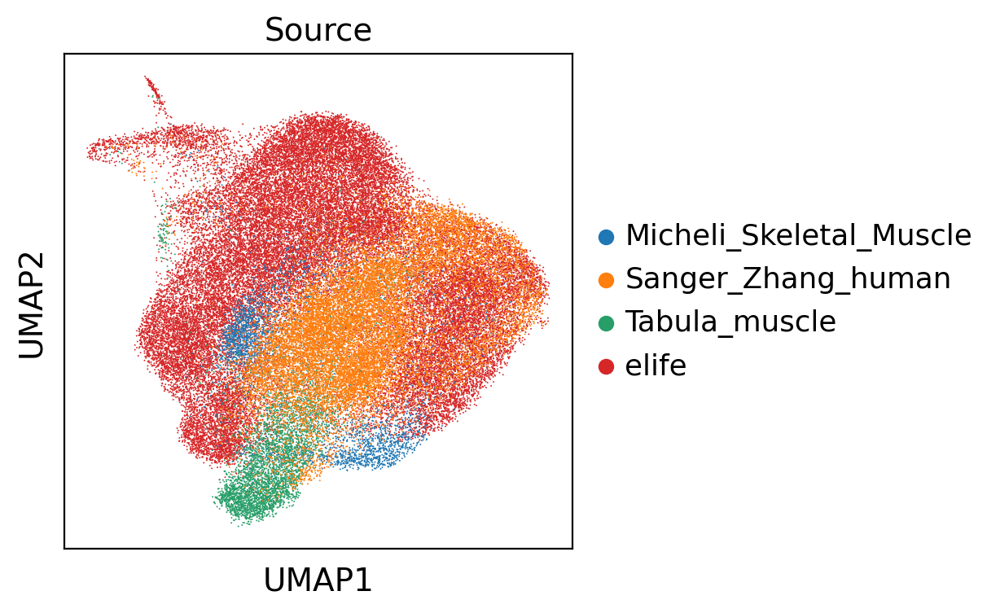

In [25]:
sc.pl.umap(adata_bbknn_scale_v1, color=['Source'],)

/home/LiuTL/anaconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


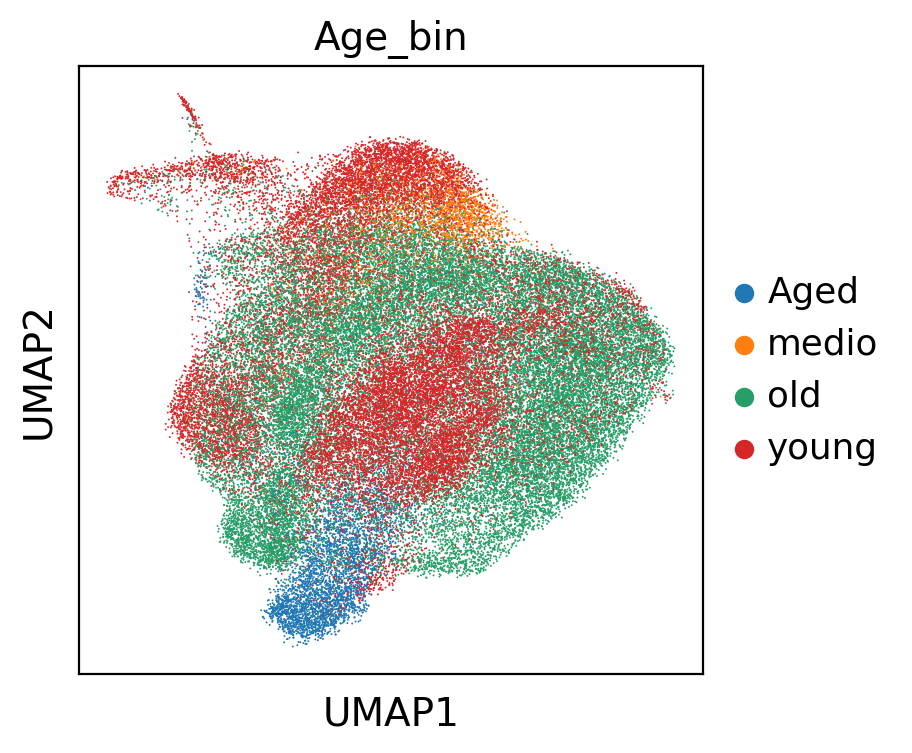

In [24]:
sc.pl.umap(adata_bbknn_scale_v1, color=['Age_bin'],)

/home/LiuTL/anaconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


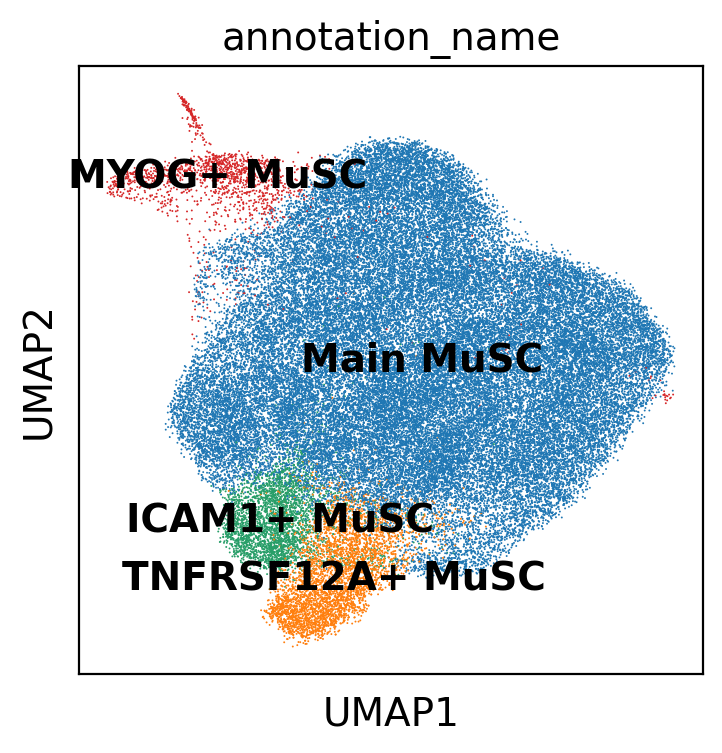

In [6]:
sc.pl.umap(adata_bbknn_scale_v1, color=['annotation_name'],legend_loc='on data')

In [7]:
adata_bbknn_scale_v1.obs

,Sample_ID,doublet_scores,Sex,Age_yo,Muscle,Age_bin,batch,Source,Species,10X_chemistry,...,total_counts,log1p_total_counts,pct_counts_in_top_50_genes,pct_counts_in_top_100_genes,pct_counts_in_top_200_genes,pct_counts_in_top_500_genes,leiden,score,Age_bin1,annotation_name
CTCAGGGGTCGGAAAC-1-2-0,Rectus56F,0.045763,female,56,Rectus_abdominis,old,0,elife,human,v3,...,506.0,6.228511,33.399209,48.221344,67.984190,100.000000,6,0.244388,Aged,Main MuSC
GTAGAGGGTCACCGCA-1-2-0,Rectus56F,0.049953,female,56,Rectus_abdominis,old,0,elife,human,v3,...,654.0,6.484635,27.522936,38.990826,54.281346,100.000000,6,0.265269,Aged,Main MuSC
GGGCGTTAGAGTCGAC-1-2-0,Rectus56F,0.138462,female,56,Rectus_abdominis,old,0,elife,human,v3,...,832.0,6.725034,30.649038,44.230769,58.894231,94.951923,6,0.326252,Aged,Main MuSC
TTCACCGGTTCAGTAC-1-2-0,Rectus56F,0.082873,female,56,Rectus_abdominis,old,0,elife,human,v3,...,620.0,6.431331,27.419355,39.677419,55.806452,100.000000,6,0.198494,Aged,Main MuSC
CAAGACTTCGGTGTAT-1-2-0,Rectus56F,0.097561,female,56,Rectus_abdominis,old,0,elife,human,v3,...,828.0,6.720220,32.004831,45.772947,59.903382,96.135266,6,0.306364,Aged,Main MuSC
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
WS_A_SKM9845430-ACAGCCGTCGGTGCAC-1-3,591C,NaN,male,38,Intercostal_Muscles,young,3,Sanger_Zhang_human,human,v2,...,531.0,6.276643,41.054614,57.250471,76.082863,100.000000,0,0.278127,young,Main MuSC
WS_A_SKM9845430-GGAGATGTCAAACGAA-1-3,591C,NaN,male,38,Intercostal_Muscles,young,3,Sanger_Zhang_human,human,v2,...,501.0,6.218600,40.718563,59.680639,79.640719,100.000000,0,0.369141,young,Main MuSC
WS_A_SKM9845430-TGATGGTGTCGCGTTG-1-3,591C,NaN,male,38,Intercostal_Muscles,young,3,Sanger_Zhang_human,human,v2,...,506.0,6.228511,36.363636,51.581028,71.343874,100.000000,0,0.315779,young,Main MuSC
WS_A_SKM9845430-CATGCTCAGAATCTAG-1-3,591C,NaN,male,38,Intercostal_Muscles,young,3,Sanger_Zhang_human,human,v2,...,511.0,6.238325,38.356164,54.403131,73.972603,100.000000,0,0.326847,young,Main MuSC


In [8]:
adata_ICA = adata_bbknn_scale_v1[adata_bbknn_scale_v1.obs['annotation_name']=='ICAM1+ MuSC']

In [9]:
adata_ICA

View of AnnData object with n_obs × n_vars = 3480 × 1788
    obs: 'Sample_ID', 'doublet_scores', 'Sex', 'Age_yo', 'Muscle', 'Age_bin', 'batch', 'Source', 'Species', '10X_chemistry', 'Mito_per', 'annotation', 'annotation_old', 'anatomical_information', 'n_genes', 'n_counts', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'leiden', 'score', 'Age_bin1', 'annotation_name'
    var: 'GeneName-0', 'mito-0', 'GeneName-1', 'mito-2', 'gene_ids-2', 'n_cells-2', 'GeneName-3', 'n_cells-3', 'GeneID-3', 'feature_types-3', 'genome-3', 'n_counts-3', 'human_gene-3', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'Muscle_colors', 'Sample_ID_colors', 'Source_colors', 'annotation_name_colors

/home/LiuTL/anaconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


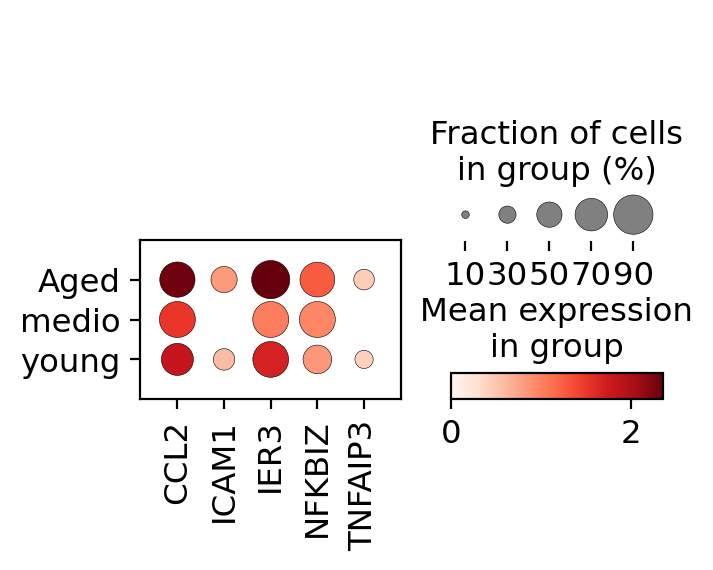

In [10]:
sc.pl.dotplot(adata_ICA,['CCL2','ICAM1','IER3','NFKBIZ','TNFAIP3'],groupby=['Age_bin1'])

In [16]:
adata_ICA_clean = adata_ICA[adata_ICA.obs['Age_bin1']!='medio']

/home/LiuTL/anaconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


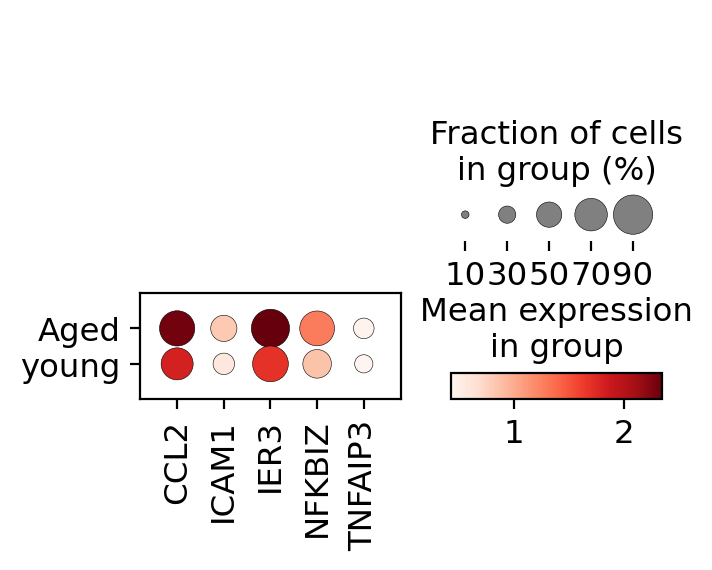

In [17]:
sc.pl.dotplot(adata_ICA_clean,['CCL2','ICAM1','IER3','NFKBIZ','TNFAIP3'],groupby=['Age_bin1'])

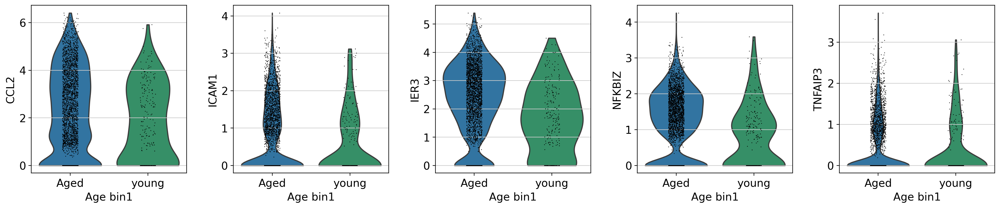

In [18]:
sc.pl.violin(adata_ICA_clean,['CCL2','ICAM1','IER3','NFKBIZ','TNFAIP3'],groupby='Age_bin1')

/home/LiuTL/anaconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


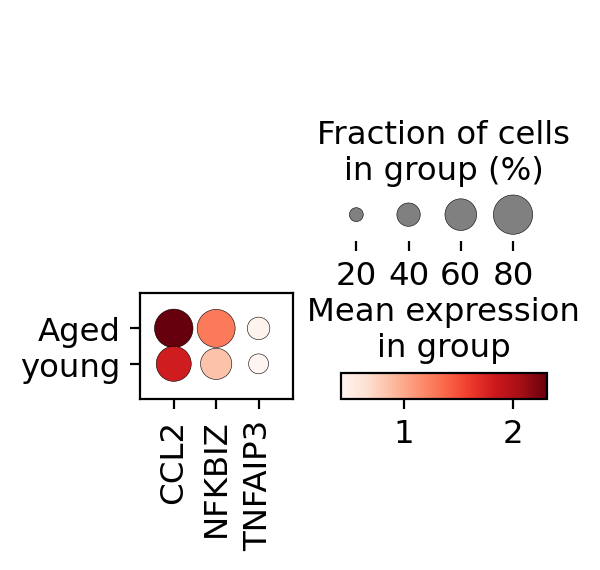

In [23]:
sc.pl.dotplot(adata_ICA_clean,['CCL2','NFKBIZ','TNFAIP3'],groupby=['Age_bin1'])

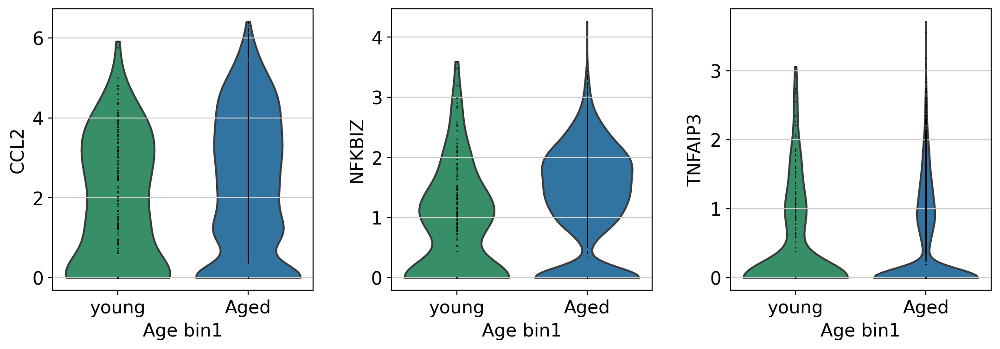

In [22]:
sc.pl.violin(adata_ICA_clean,['CCL2','NFKBIZ','TNFAIP3'],groupby='Age_bin1',
             order=['young','Aged',],jitter=False,)

/home/LiuTL/anaconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


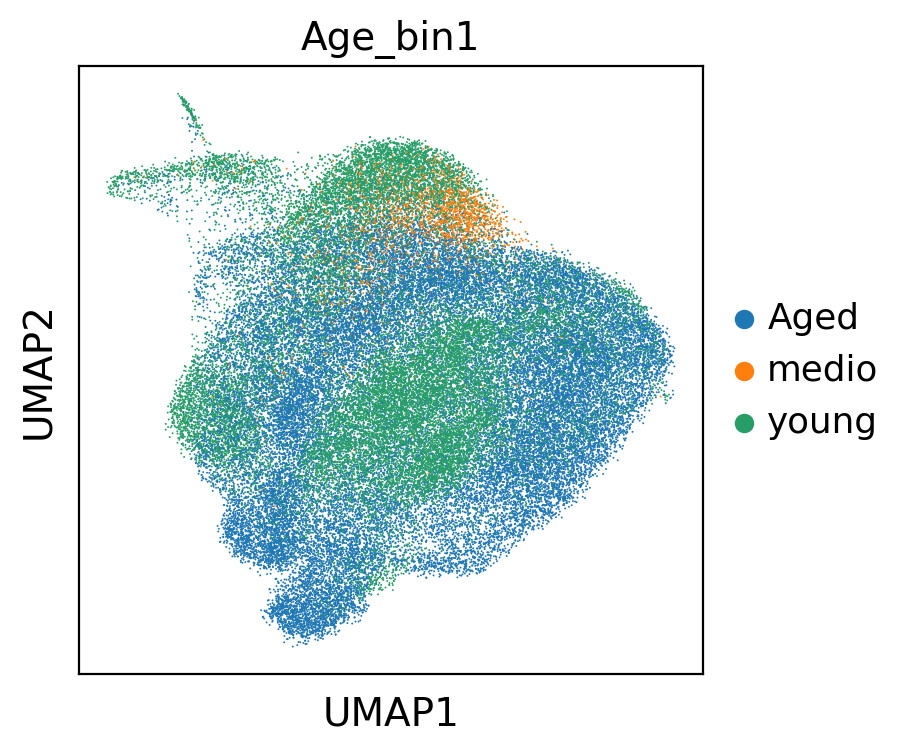

In [13]:
sc.pl.umap(adata_bbknn_scale_v1, color=['Age_bin1'],)

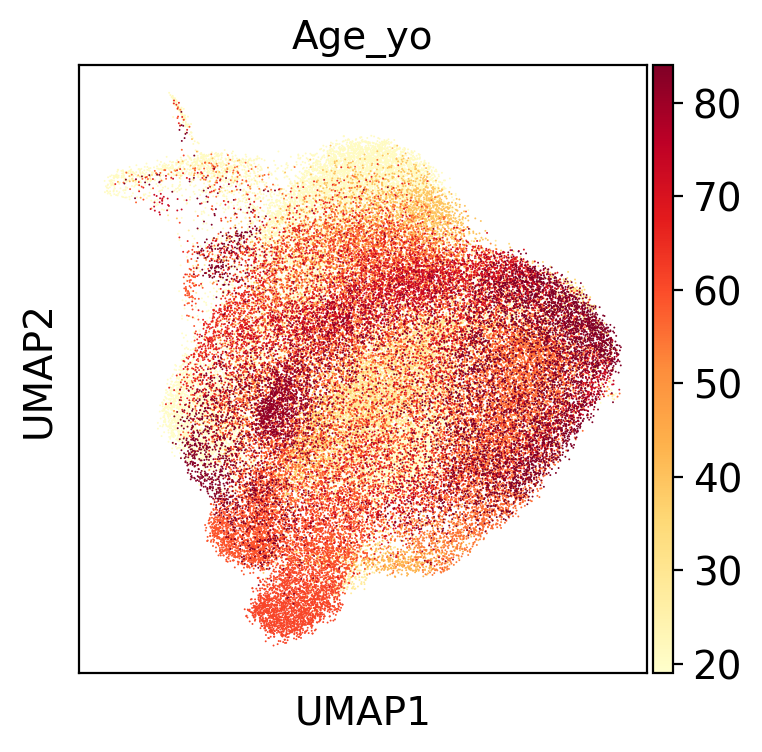

In [14]:
sc.pl.umap(adata_bbknn_scale_v1, color=['Age_yo'],)

/home/LiuTL/anaconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


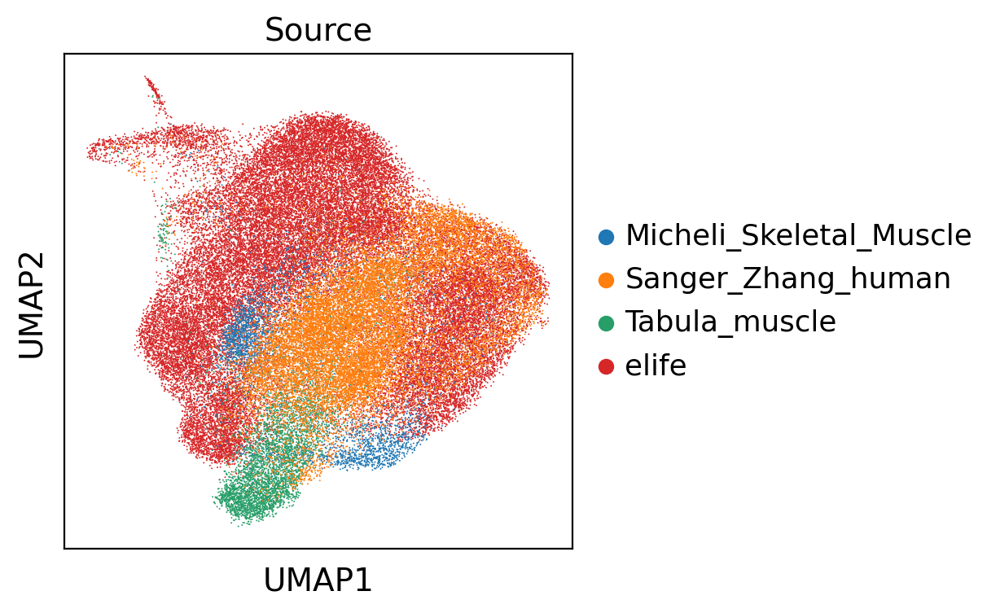

In [15]:
sc.pl.umap(adata_bbknn_scale_v1, color=['Source'],)

/home/LiuTL/anaconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


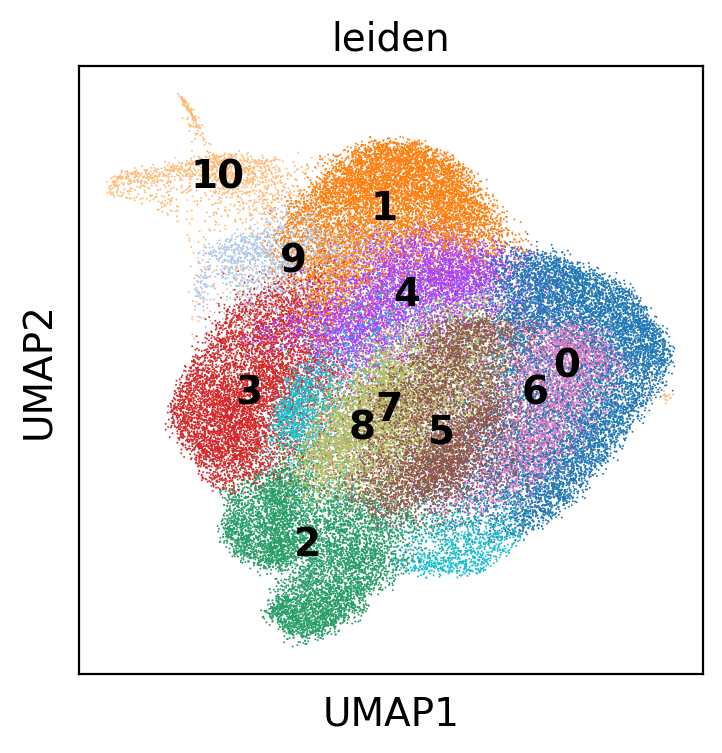

In [81]:
sc.pl.umap(adata_bbknn_scale_v1, color=['leiden'],legend_loc='on data')

In [83]:
adata_bbknn_scale_v1

AnnData object with n_obs × n_vars = 62575 × 1788
    obs: 'Sample_ID', 'doublet_scores', 'Sex', 'Age_yo', 'Muscle', 'Age_bin', 'batch', 'Source', 'Species', '10X_chemistry', 'Mito_per', 'annotation', 'annotation_old', 'anatomical_information', 'n_genes', 'n_counts', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'leiden', 'score', 'Age_bin1'
    var: 'GeneName-0', 'mito-0', 'GeneName-1', 'mito-2', 'gene_ids-2', 'n_cells-2', 'GeneName-3', 'n_cells-3', 'GeneID-3', 'feature_types-3', 'genome-3', 'n_counts-3', 'human_gene-3', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'log1p', 'hvg', 'pca', 'Sample_ID_colors', 'neighbors', 'umap', 'leiden', 'leiden_colors', 'Source_colo

In [68]:
age_list = []
for i in list(adata_bbknn_scale_v1.obs['Age_bin']):
    if i == 'old':
        age_list.append('Aged')
    else:age_list.append(i)

In [69]:
adata_bbknn_scale_v1.obs['Age_bin1'] = age_list

In [72]:
adata_6 = adata_bbknn_scale_v1[adata_bbknn_scale_v1.obs['leiden']=='2']

/home/LiuTL/anaconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


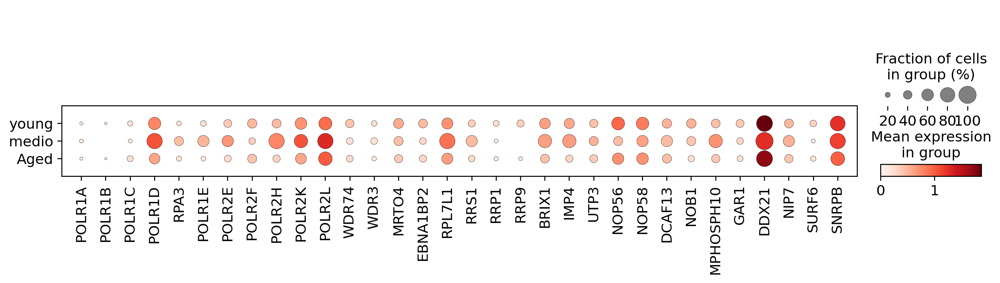

In [73]:
sc.pl.dotplot(adata_6,['POLR1A','POLR1B','POLR1C','POLR1D',  'RPA3','POLR1E',  'POLR2E','POLR2F','POLR2H','POLR2K','POLR2L','WDR74','WDR3','MRTO4','EBNA1BP2','RPL7L1','RRS1','RRP1','RRP9','BRIX1','IMP4','UTP3','NOP56','NOP58','DCAF13','NOB1','MPHOSPH10','GAR1','DDX21','NIP7','SURF6','SNRPB'],groupby='Age_bin1',categories_order=['young','medio','Aged'])

/home/LiuTL/anaconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


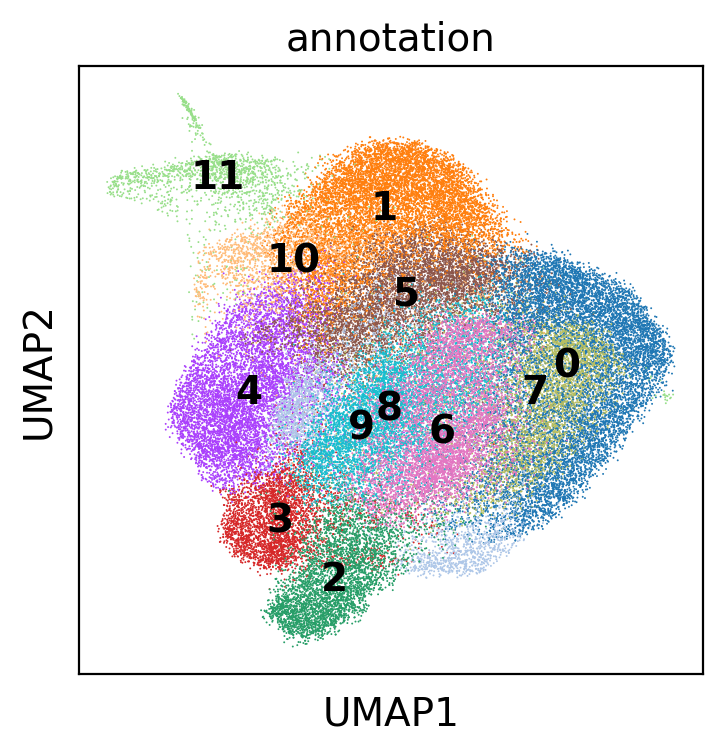

In [84]:
sc.pl.umap(adata_bbknn_scale_v1, color=['annotation'],legend_loc='on data')

In [51]:
adata_bbknn_scale_v1.obs['annotation'] = adata_bbknn_scale_v1.obs['leiden']

/home/LiuTL/anaconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


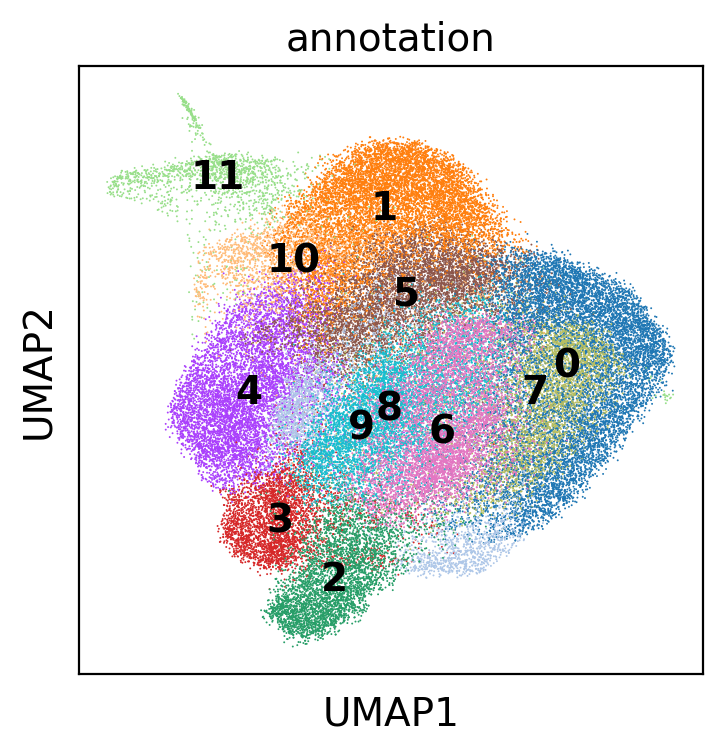

In [85]:
sc.pl.umap(adata_bbknn_scale_v1, color=['annotation'],legend_loc='on data')

running Leiden clustering
    finished: found 4 clusters and added
    'leiden_R', the cluster labels (adata.obs, categorical) (0:00:56)


/home/LiuTL/anaconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


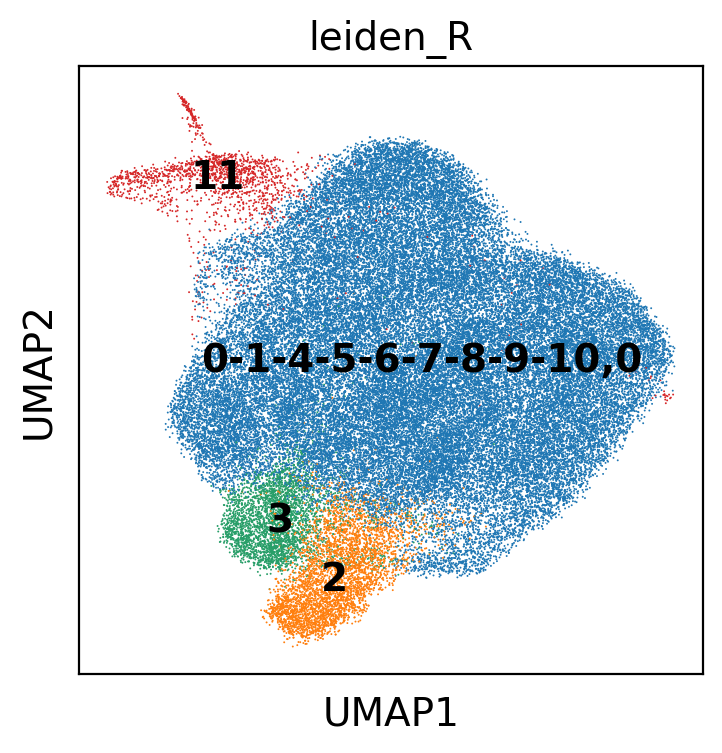

In [87]:
sc.tl.leiden(adata_bbknn_scale_v1, resolution=.0, restrict_to=('annotation', ['0','1','4','5','6','7','8','9','10']))
sc.pl.umap(adata_bbknn_scale_v1, color='leiden_R',legend_loc='on data')

In [88]:
adata_bbknn_scale_v1.obs['leiden_R'].cat.categories = [str(i) for i in range(len(adata_bbknn_scale_v1.obs['leiden_R'].cat.categories))]
adata_bbknn_scale_v1.obs['annotation'] = adata_bbknn_scale_v1.obs['leiden_R']
del adata_bbknn_scale_v1.obs['leiden_R']
# sc.pl.umap(adata, color='annotation', legend_loc='on data')

/tmp/ipykernel_71847/1003342946.py:1: FutureWarning: Setting categories in-place is deprecated and will raise in a future version. Use rename_categories instead.
  adata_bbknn_scale_v1.obs['leiden_R'].cat.categories = [str(i) for i in range(len(adata_bbknn_scale_v1.obs['leiden_R'].cat.categories))]


In [95]:
adata_bbknn_scale_v1.obs['annotation_name'] = adata_bbknn_scale_v1.obs['annotation']

In [96]:
new_cluster_name = ['Main MuSC','TNFRSF12A+ MuSC','ICAM1+ MuSC','MYOG+ MuSC']
adata_bbknn_scale_v1.rename_categories('annotation_name', new_cluster_name)

/home/LiuTL/anaconda3/envs/scanpy/lib/python3.8/site-packages/anndata/_core/anndata.py:1160: FutureWarning: The `inplace` parameter in pandas.Categorical.rename_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  self.obs[key].cat.rename_categories(categories, inplace=True)


In [110]:
adata_clean = adata_bbknn_scale_v1[adata_bbknn_scale_v1.obs['Muscle']!='nan']

In [111]:
adata_clean

View of AnnData object with n_obs × n_vars = 62343 × 1788
    obs: 'Sample_ID', 'doublet_scores', 'Sex', 'Age_yo', 'Muscle', 'Age_bin', 'batch', 'Source', 'Species', '10X_chemistry', 'Mito_per', 'annotation', 'annotation_old', 'anatomical_information', 'n_genes', 'n_counts', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'leiden', 'score', 'Age_bin1', 'annotation_name'
    var: 'GeneName-0', 'mito-0', 'GeneName-1', 'mito-2', 'gene_ids-2', 'n_cells-2', 'GeneName-3', 'n_cells-3', 'GeneID-3', 'feature_types-3', 'genome-3', 'n_counts-3', 'human_gene-3', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'log1p', 'hvg', 'pca', 'Sample_ID_colors', 'neighbors', 'umap', 'leiden', 'l

/home/LiuTL/anaconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


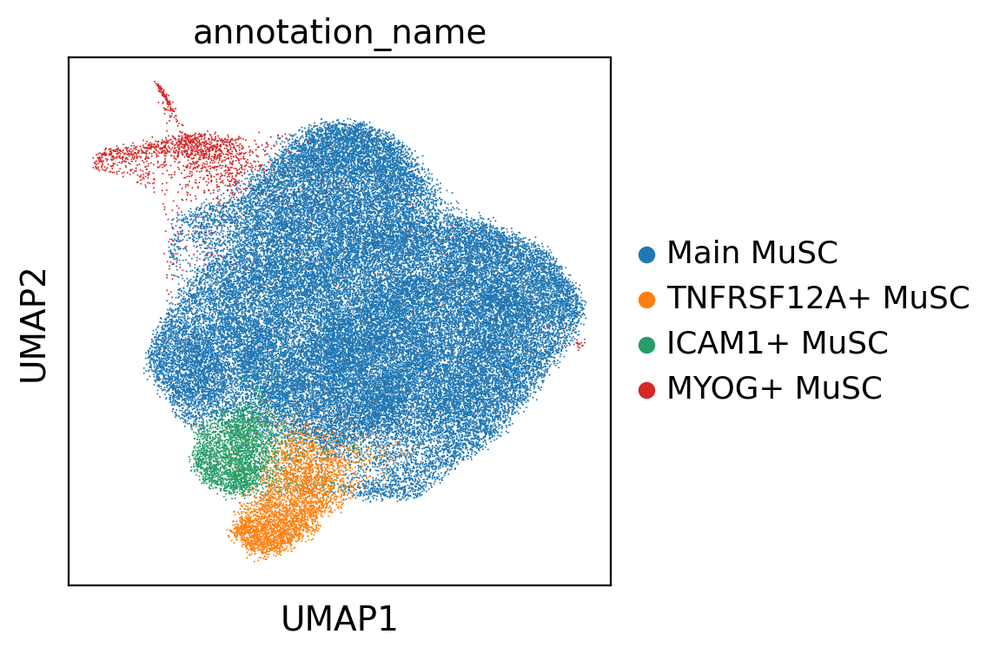

In [114]:
sc.pl.umap(adata_clean, color=['annotation_name'],save='human_MuSC_all_muscle_bbknn_v1.1_anno.pdf')

/home/LiuTL/anaconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


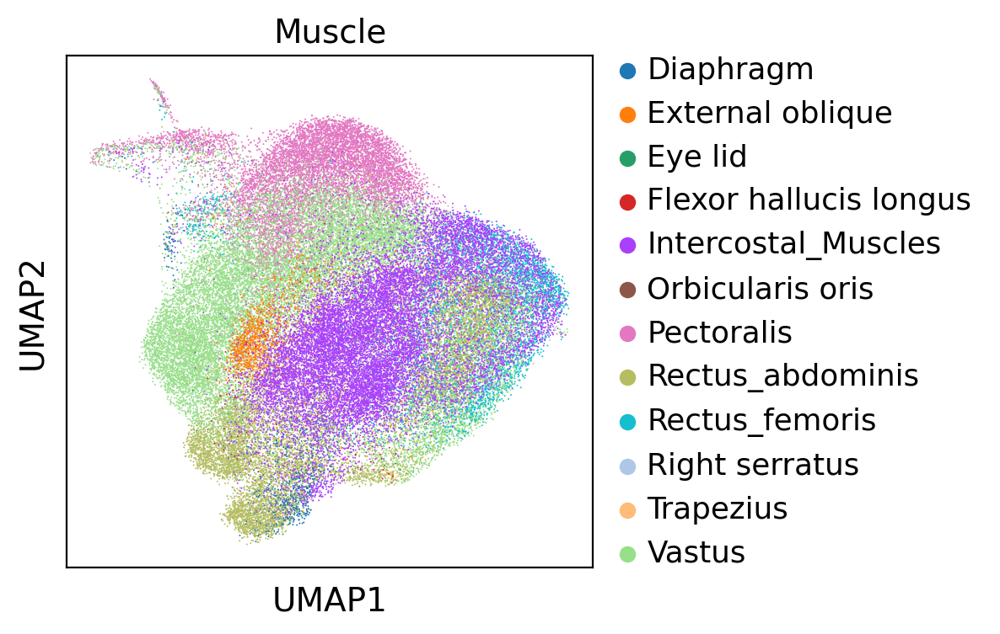

In [113]:
sc.pl.umap(adata_clean, color=['Muscle'],
          save='human_MuSC_all_muscle_bbknn_v1.1_Muscle.pdf')

In [116]:
collections.Counter(adata_clean.obs['Muscle'])

Counter({'Rectus_abdominis': 11092,
         'Vastus': 18727,
         'Pectoralis': 9106,
         'Rectus_femoris': 4927,
         'Trapezius': 320,
         'External oblique': 1310,
         'Flexor hallucis longus': 91,
         'Right serratus': 15,
         'Orbicularis oris': 6,
         'Eye lid': 19,
         'Diaphragm': 942,
         'Intercostal_Muscles': 15788})

In [121]:
adata_bbknn_scale_v1

AnnData object with n_obs × n_vars = 62575 × 1788
    obs: 'Sample_ID', 'doublet_scores', 'Sex', 'Age_yo', 'Muscle', 'Age_bin', 'batch', 'Source', 'Species', '10X_chemistry', 'Mito_per', 'annotation', 'annotation_old', 'anatomical_information', 'n_genes', 'n_counts', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'leiden', 'score', 'Age_bin1', 'annotation_name'
    var: 'GeneName-0', 'mito-0', 'GeneName-1', 'mito-2', 'gene_ids-2', 'n_cells-2', 'GeneName-3', 'n_cells-3', 'GeneID-3', 'feature_types-3', 'genome-3', 'n_counts-3', 'human_gene-3', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'log1p', 'hvg', 'pca', 'Sample_ID_colors', 'neighbors', 'umap', 'leiden', 'leiden_co

/home/LiuTL/anaconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


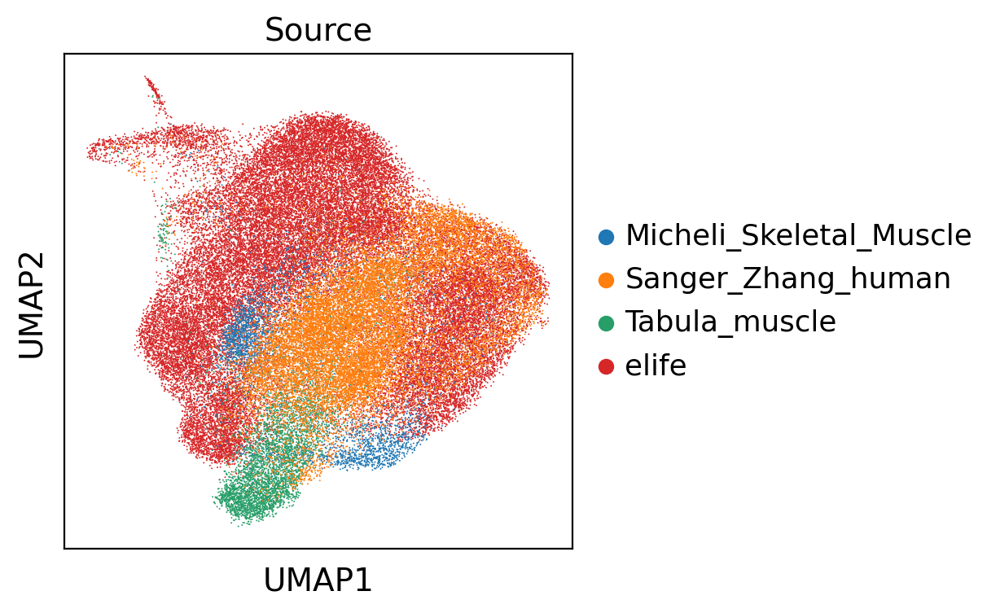

In [120]:
sc.pl.umap(adata_bbknn_scale_v1, color=['Source'],
           save='human_MuSC_all_muscle_bbknn_v1.1_source.pdf')

/home/LiuTL/anaconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


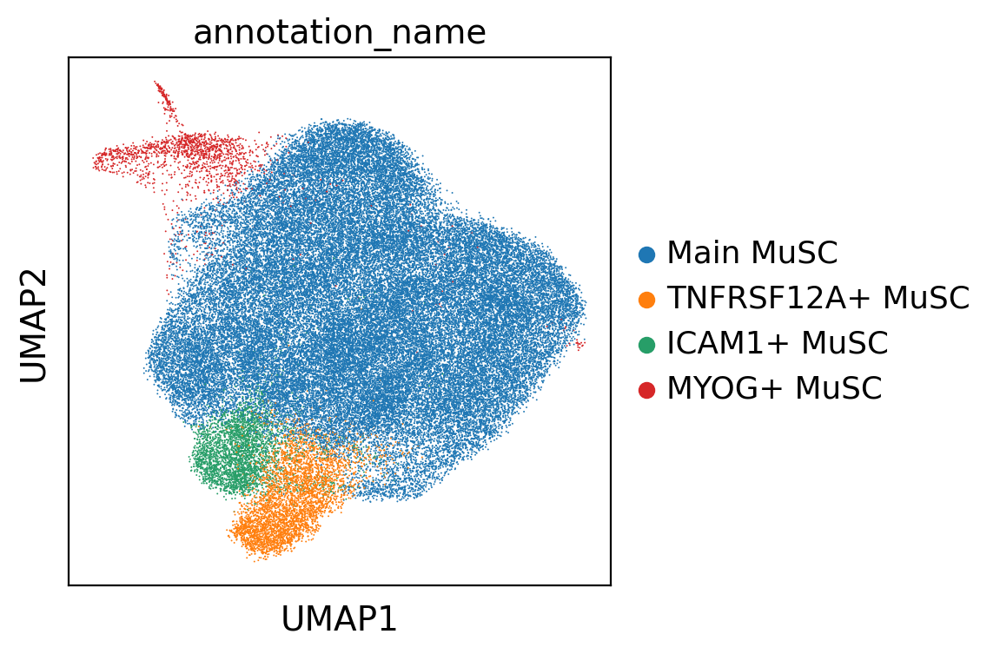

In [123]:
sc.pl.umap(adata_bbknn_scale_v1, color=['annotation_name'])

In [137]:
adata_ICAM12 = adata_clean2[adata_clean2.obs['annotation_name']=='ICAM1+ MuSC']

In [126]:
adata_clean

View of AnnData object with n_obs × n_vars = 62343 × 1788
    obs: 'Sample_ID', 'doublet_scores', 'Sex', 'Age_yo', 'Muscle', 'Age_bin', 'batch', 'Source', 'Species', '10X_chemistry', 'Mito_per', 'annotation', 'annotation_old', 'anatomical_information', 'n_genes', 'n_counts', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'leiden', 'score', 'Age_bin1', 'annotation_name'
    var: 'GeneName-0', 'mito-0', 'GeneName-1', 'mito-2', 'gene_ids-2', 'n_cells-2', 'GeneName-3', 'n_cells-3', 'GeneID-3', 'feature_types-3', 'genome-3', 'n_counts-3', 'human_gene-3', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'log1p', 'hvg', 'pca', 'Sample_ID_colors', 'neighbors', 'umap', 'leiden', 'l

/home/LiuTL/anaconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: In a future version of pandas all arguments of Categorical.replace except for the argument 'value' will be keyword-only.
  values = values.replace(values.categories.difference(groups), np.nan)
/home/LiuTL/anaconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)
/home/LiuTL/anaconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


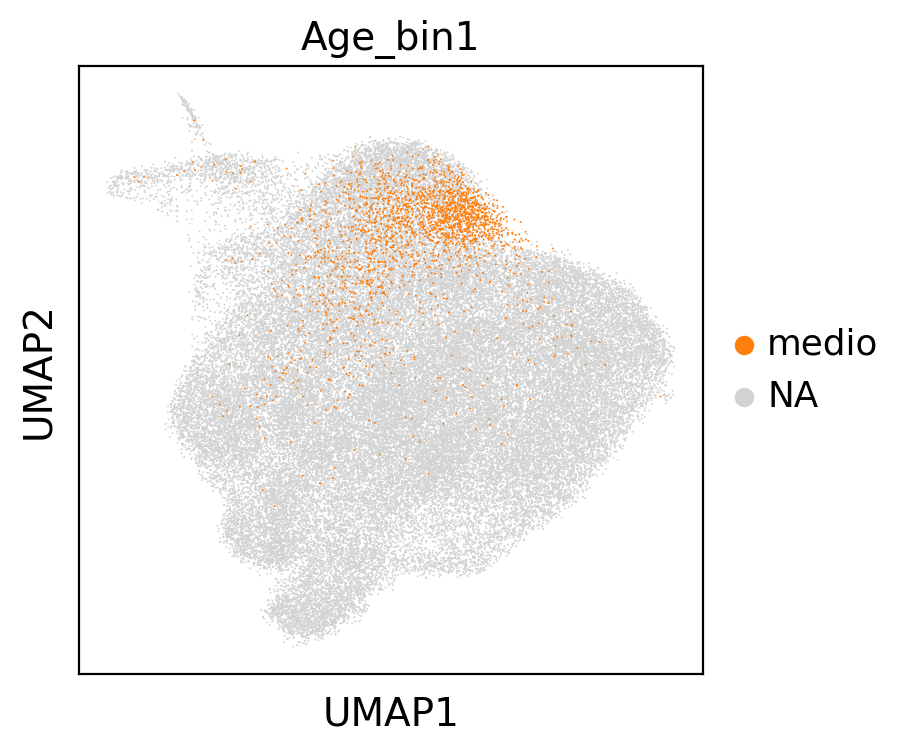

In [128]:
sc.pl.umap(adata_bbknn_scale_v1, color=['Age_bin1'],groups='medio')

In [129]:
adata_clean2 = adata_clean[adata_clean.obs['Age_bin1']!='medio']

/home/LiuTL/anaconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


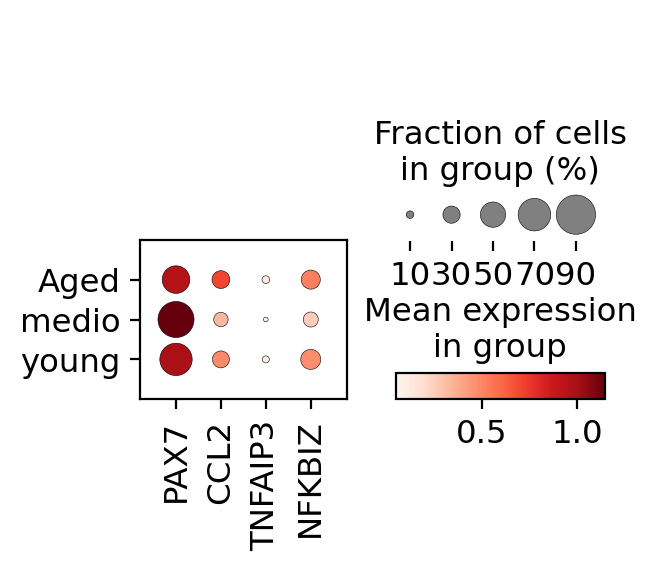

In [131]:
sc.pl.dotplot(adata_clean,['PAX7','CCL2','TNFAIP3','NFKBIZ'],groupby='Age_bin1',)

/home/LiuTL/anaconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


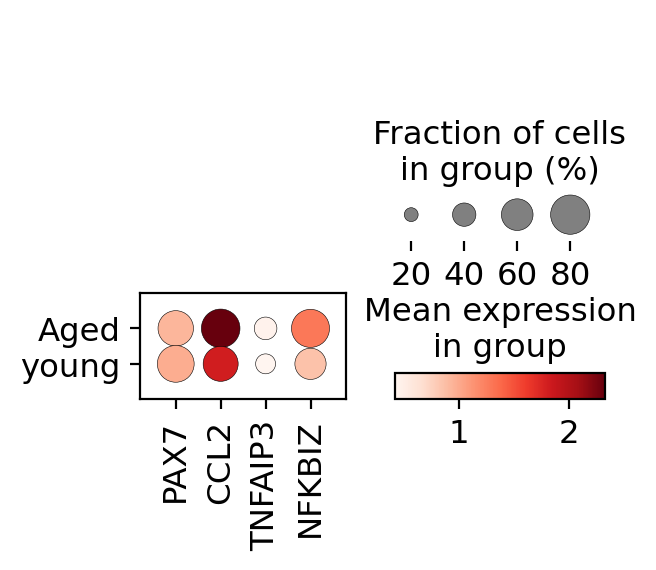

In [138]:
sc.pl.dotplot(adata_ICAM12,['PAX7','CCL2','TNFAIP3','NFKBIZ'],groupby='Age_bin1',)

In [ ]:
sc.pl.dotplot(adata_clean2,['PAX7','MYF5','SPRY1','CCL2','TNFAIP3','NFKBIZ'],groupby='Age_bin1',)

/home/LiuTL/anaconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


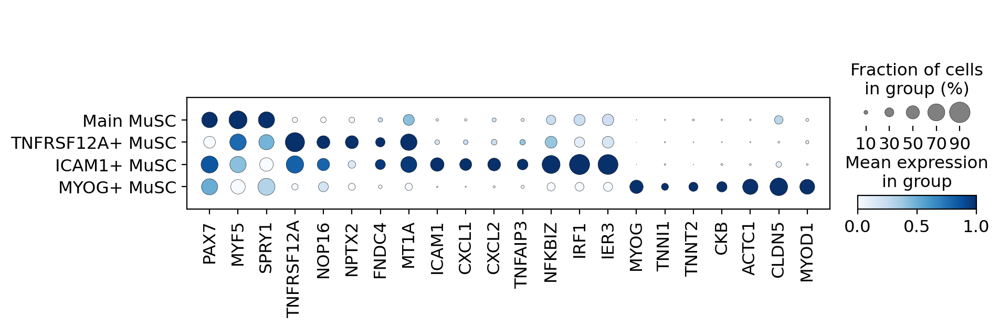

In [115]:
sc.pl.dotplot(adata_clean,['PAX7','MYF5','SPRY1','TNFRSF12A','NOP16','NPTX2','FNDC4','MT1A','ICAM1','CXCL1','CXCL2','TNFAIP3','NFKBIZ','IRF1','IER3','MYOG','TNNI1','TNNT2','CKB','ACTC1','CLDN5','MYOD1'],groupby='annotation_name',
              #categories_order=['Main-MuSCs','TNFRSF12A+MuSCs','CD54+MuSCs','MYOG+MuSCs',],
              cmap='Blues',
              standard_scale='var',
              save='human_MuSC_all_muscle_bbknn_v1.1_marker_blue1.pdf')

In [105]:
# 'Main MuSC','TNFRSF12A+ MuSC','ICAM1+ MuSC','MYOG+ MuSC'
adata_mai = adata_bbknn_scale_v1[adata_bbknn_scale_v1.obs['annotation_name']=='Main MuSC']
adata_tnf = adata_bbknn_scale_v1[adata_bbknn_scale_v1.obs['annotation_name']=='TNFRSF12A+ MuSC']
adata_ica = adata_bbknn_scale_v1[adata_bbknn_scale_v1.obs['annotation_name']=='ICAM1+ MuSC']
adata_myg = adata_bbknn_scale_v1[adata_bbknn_scale_v1.obs['annotation_name']=='MYOG+ MuSC']

/home/LiuTL/anaconda3/envs/scanpy/lib/python3.8/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


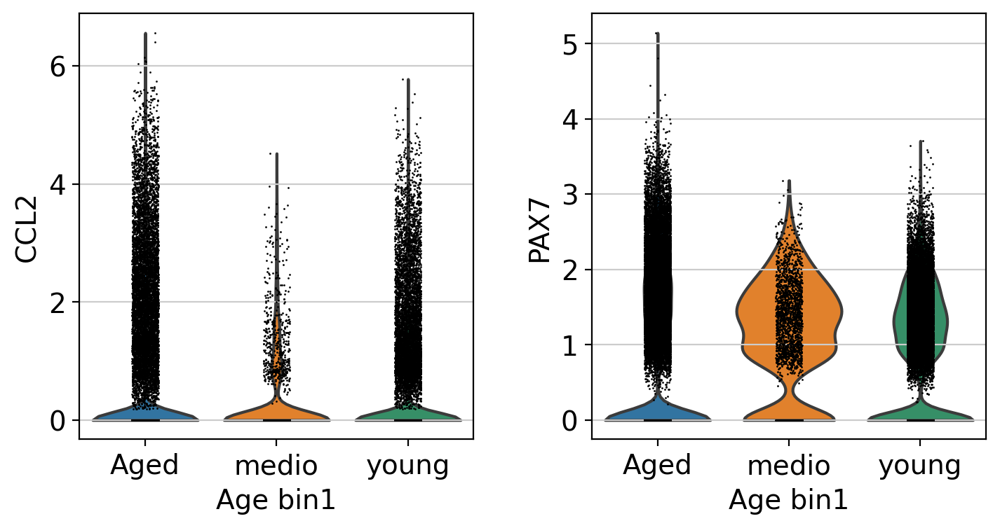

In [107]:
sc.pl.violin(adata_mai,['CCL2','PAX7'],groupby='Age_bin1')

/home/LiuTL/anaconda3/envs/scanpy/lib/python3.8/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


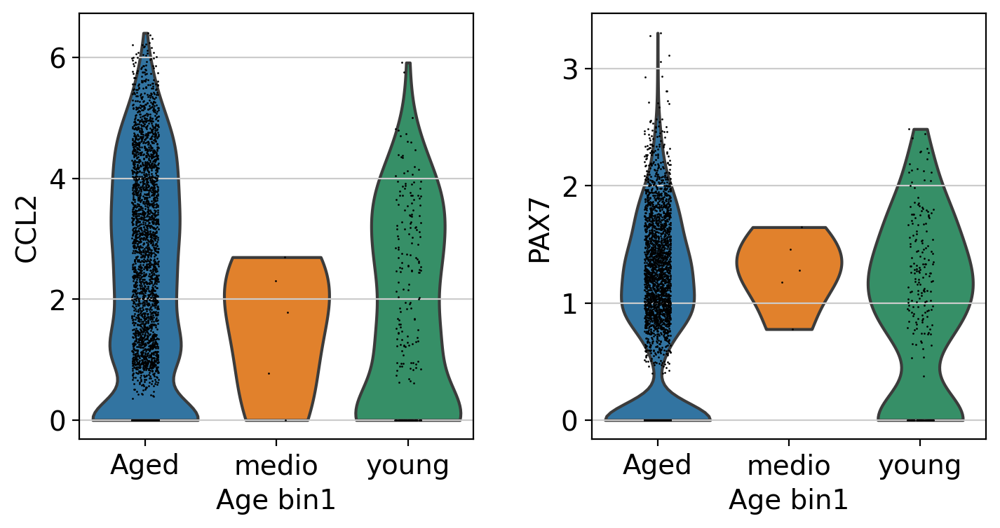

In [108]:
sc.pl.violin(adata_ica,['CCL2','PAX7'],groupby='Age_bin1')

In [ ]:
sc.pl.violin(adata_ica,['CCL2','PAX7'],groupby='Age_bin1')

/home/LiuTL/anaconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


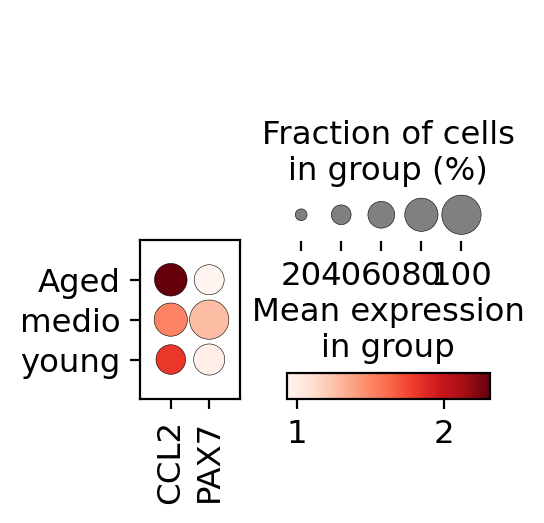

In [109]:
sc.pl.dotplot(adata_ica,['CCL2','PAX7'],groupby='Age_bin1')

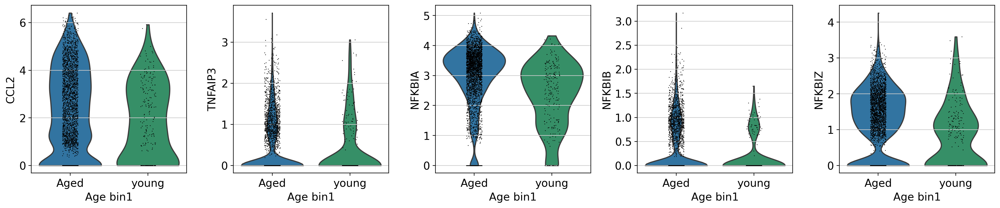

In [139]:
sc.pl.violin(adata_ICAM12,['CCL2','TNFAIP3','NFKBIA','NFKBIB','NFKBIZ'],groupby='Age_bin1')

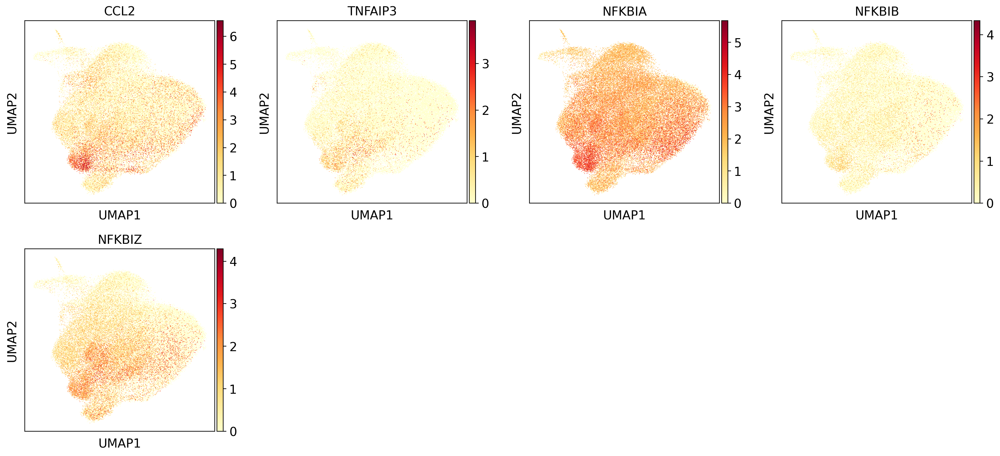

In [140]:
sc.pl.umap(adata_clean2,color=['CCL2','TNFAIP3','NFKBIA','NFKBIB','NFKBIZ'])

In [60]:
sc.tl.score_genes(adata_bbknn_scale_v1,gene_list=['AATF','ABCE1','ABT1','BMS1','BOP1','BRIX1','BYSL','C1D','C1QBP','CHD7','CUL4A','CUL4B','DCAF13','DDX10','DDX17','DDX18','DDX21','DDX27','DDX28','DDX31','DDX3X','DDX47','DDX49','DDX51','DDX52','DDX54','DDX56','DHX29','DHX30','DHX37','DIMT1','DIS3','DKC1','DROSHA','EBNA1BP2','EIF2A','EIF4A3','EIF6','EMG1','ERAL1','ERCC2','ERI1','ERI2','ERI3','ESF1','EXOSC1','EXOSC10','EXOSC2','EXOSC3','EXOSC4','EXOSC5','EXOSC6','EXOSC7','EXOSC8','EXOSC9','FASTKD2','FBL','FBLL1','FCF1','FDXACB1','FRG1','FTSJ3','GAR1','GEMIN4','GLUL','GNL2','GNL3L','GPATCH4','GTF2H5','GTF3A','GTPBP10','GTPBP4','HEATR1','HEATR3','HELB','HELQ','IMP3','IMP4','ISG20','ISG20L2','KAT2B','KRI1','KRR1','LAS1L','LSG1','LSM6','LTV1','LYAR','MAK16','MALSU1','MDN1','METTL15','METTL16','METTL17','METTL18','METTL5','MPHOSPH10','MPHOSPH6','MPV17L2','MRM1','MRPL1','MRPL20','MRPL22','MRPL36','MRPS11','MRPS2','MRPS7','MRTO4','MTERF3','MTERF4','MTG2','MYBBP1A','NAF1','NAT10','NGDN','NGRN','NHP2','NIFK','NIP7','NLE1','NMD3','NOB1','NOC2L','NOC4L','NOL10','NOL11','NOL6','NOL8','NOL9','NOLC1','NOM1','NOP10','NOP14','NOP16','NOP2','NOP56','NOP58','NOP9','NPM1','NPM3','NSA2','NSUN3','NSUN4','NSUN5','NUDT16','NUP88','NVL','PA2G4','PAK1IP1','PDCD11','PES1','PIH1D1','PIH1D2','PIN4','PINX1','POP4','POP5','POP7','PPAN','PRKDC','PTEN','PWP1','PWP2','RAN','RBFA','RCL1','REXO4','RIOK1','RIOK2','RIOK3','RMRP','RNASEL','RPF1','RPF2','RPL10','RPL10A','RPL10L','RPL11','RPL14','RPL23A','RPL24','RPL26','RPL26L1','RPL27','RPL3','RPL35','RPL35A','RPL38','RPL3L','RPL5','RPL6','RPL7','RPL7A','RPL7L1','RPLP0','RPP25','RPP30','RPP38','RPP40','RPS14','RPS15','RPS16','RPS17','RPS19','RPS21','RPS24','RPS25','RPS27','RPS27L','RPS28','RPS5','RPS6','RPS7','RPS8','RPSA','RPUSD1','RPUSD2','RPUSD3','RPUSD4','RRN3','RRP1','RRP12','RRP15','RRP1B','RRP36','RRP7A','RRP8','RRP9','RRS1','RSL1D1','RSL24D1','SART1','SBDS','SDAD1','SHQ1','SIRT7','SNU13','SRFBP1','SURF6','SUV39H1','TBL3','TFB1M','TFB2M','TRAF7','TRMT112','TRMT61B','TSC1','TSR1','TSR2','TSR3','URB1','URB2','USP36','UTP14A','UTP14C','UTP15','UTP18','UTP20','UTP23','UTP3','UTP4','UTP6','VCX','WBP11','WDR12','WDR18','WDR3','WDR36','WDR43','WDR46','WDR55','WDR74','WDR75','XPO1','XRCC5','XRN2','YBEY','YTHDF2','ZCCHC4','ZNF622','ZNF658','ZNHIT3','ZNHIT6',])

computing score 'score'


/home/LiuTL/anaconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):


    finished: added
    'score', score of gene set (adata.obs).
    988 total control genes are used. (0:00:02)


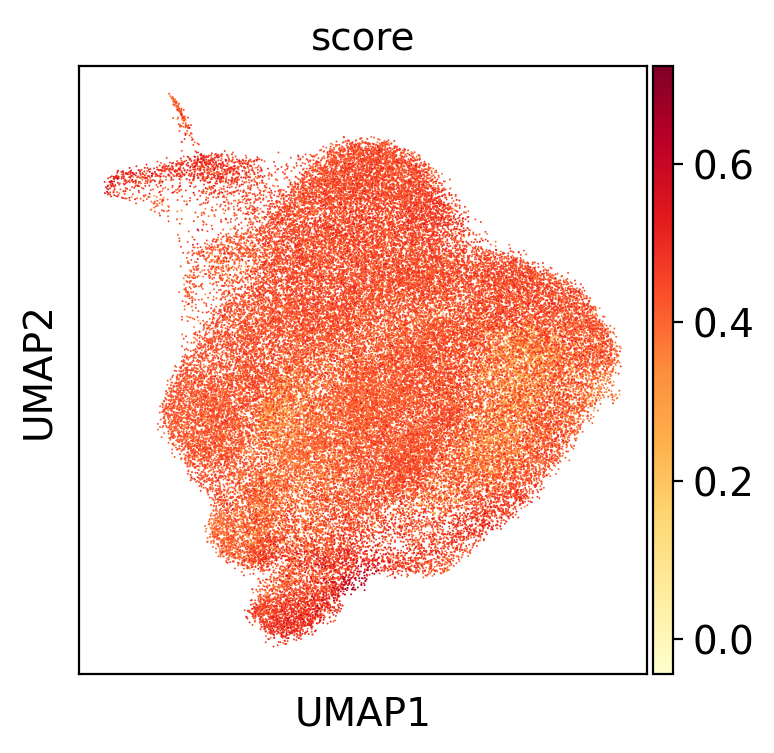

In [61]:
sc.pl.umap(adata_bbknn_scale_v1,color=['score'],)

/home/LiuTL/anaconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


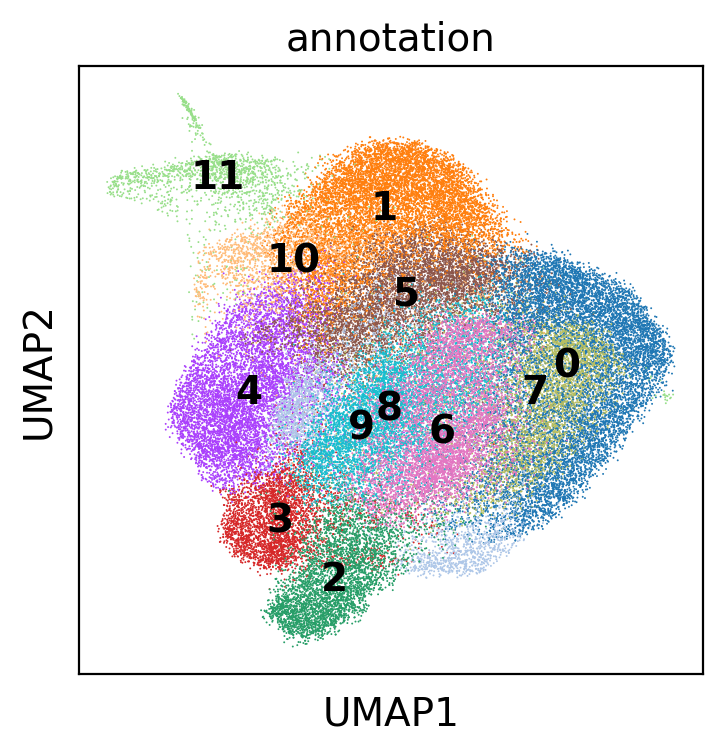

In [58]:
sc.pl.umap(adata_bbknn_scale_v1, color=['annotation'],legend_loc='on data')

In [62]:
pd.DataFrame(adata_bbknn_scale_v1.obs)[['Sample_ID','annotation','Age_bin','score']].to_csv('./write/human_MuSC_all_muscle_bbknn_v1.1_obs.csv')

In [89]:
pd.DataFrame(adata_bbknn_scale_v1.obs)[['Sample_ID','annotation','Age_bin','score']].to_csv('./write/human_MuSC_all_muscle_bbknn_v1.1_obs_v2.csv')